In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import os
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd

In [3]:
import matplotlib.gridspec as gridspec
import matplotlib.animation as animation
mpl.rcParams['animation.embed_limit'] = 4000

In [4]:
from windtools.common import calc_wind
from windtools.plotting import plot_timeheight, plot_timehistory_at_height, plot_profile, plot_spectrum

In [5]:
from statsmodels.tsa.stattools import acf
from scipy import integrate

In [6]:
def spatialCorrelation2D (ds, x0, y0, ti=None, tf=None, dateref=None):
    
    # Operations in time
    if dateref != None:
        ti = pd.to_datetime(ti, unit='s', origin = dateref)
        tf = pd.to_datetime(tf, unit='s', origin = dateref)
    ds = ds.sel(datetime=slice(ti,tf)).copy()
    times = ds.datetime.values
    
    #if 'wspd' not in list(ds.var()):
    #    ds['wspd'] = (ds.u**2 + ds.v**2)**0.5
    
    # find position of (x0, y0)
    iNearest = (abs(ds.x-x0)).argmin().values
    jNearest = (abs(ds.y-y0)).argmin().values
    
    print(f'Performing spatial correlation wrt to point ({ds.isel(x=iNearest).x.values}, ' \
          f'{ds.isel(y=jNearest).y.values}), between {ti} and {tf}.', end='\r', flush=True)
    
    mean = ds.sel(datetime=slice(ti,tf)).mean(dim=['datetime'])
    vlist=[]
    for i, t in enumerate(times):
        primeField = ds.sel(datetime=t) - mean
        v = primeField*primeField.isel(x=iNearest, y=jNearest)
        vlist.append(v)
    
    finalv = xr.concat(vlist, dim='datetime').mean(dim='datetime')
    finalv = finalv/finalv.isel(x=iNearest, y=jNearest)
    
    return finalv

In [7]:
def performCorrelationSubDomain (ds, nSubDomainsX, nSubDomainsY, outputnc=None, ti=133200, tf=133200+3*3600, window=1800, inc=600):
    '''
    Perform spatial correlations on subdomains with respect to the central point of each subdomain.
    This is useful on a periodic-type case in order to get smoother curves (analogous to a windowing for PSDs)

    '''
    if outputnc == None:
        outputnc = f'correlation{nSubDomainsX}x{nSubDomainsY}subdomain.nc'

    # Get subdomain limits
    xmin = ds.x[0].values;  xmax = ds.x[-1].values
    ymin = ds.y[0].values;  ymax = ds.y[-1].values
    xSubDom = np.linspace(xmin, xmax, nSubDomainsX+1)
    ySubDom = np.linspace(ymin, ymax, nSubDomainsY+1)
    x0SubDom = (xSubDom[1:] + xSubDom[:-1]) / 2
    y0SubDom = (ySubDom[1:] + ySubDom[:-1]) / 2

    vlist = []
    while ti+window <= tf:
        ti_dt = pd.to_datetime(ti, unit='s', origin=dateref)
        tf_dt = pd.to_datetime(ti+window, unit='s', origin=dateref)
        for i, _ in enumerate(xSubDom[:-1]):
            for j, _ in enumerate(ySubDom[:-1]):
                x0 = x0SubDom[i];  y0 = y0SubDom[j]
                dssub = ds.sel(x=slice(xSubDom[i],xSubDom[i+1]-1), y=slice(ySubDom[j],ySubDom[j+1]-1)).copy()

                v_curr = spatialCorrelation2D(dssub, x0=x0, y0=y0, ti=ti, tf=ti+window, dateref=dateref)
                v_curr = v_curr.expand_dims('datetime').assign_coords({'datetime': [ti_dt]})
                vlist.append(v_curr)
        ti = ti + inc

    # concatenate the resulting list. Workaround to merge same datetime together as it should
    vsubdom = xr.concat(vlist, dim='datetime').to_dataframe().dropna().to_xarray()

    vsubdom.to_netcdf(os.path.join(procdatadir, outputnc))
    
    return vsubdom

In [8]:
def getSpaceCorrAlongWindDir (ds, dsv, nSubDomainsX, nSubDomainsY, window=1800, var='wspd_corr'):
    '''
    Calculates the spatial correlation values along the streamwise and cross-stream direction.
    Streamwise direction is determined as along the mean wind direction for intervals defined
    in the correlation DataSet. Cross-stream direction is defined as 90deg from streamwise.
    
    Inputs:
    -------
    ds: xArray DataSet
        Windspeed and wind direction data, as well as grid information for all times. Usually
        the output of VTK-reading functions
    dsv: xArray DataSet
        Spatial correlation data. Output of `performCorrelationSubDomain`.
        
    Outputs:
    --------
    v_long: np.array
        Correlation along the streamwise direction (`long` for longitudinal)
    v_tran: np.array
        Correlation along the cross-stream direction (`tran` for transverse)
    x_{long,tran}: np.array
        Auxiliary array for proper plotting. `x` represents the direction
    L_{long,tran}: np.array
        Integral time scale for the streamwise and cross-stream direction, respectively
        
    '''

    # Get subdomain limits
    xmin = ds.x[0].values;  xmax = ds.x[-1].values
    ymin = ds.y[0].values;  ymax = ds.y[-1].values
    xSubDom = np.linspace(xmin, xmax, nSubDomainsX+1)
    ySubDom = np.linspace(ymin, ymax, nSubDomainsY+1)
    x0SubDom = (xSubDom[1:] + xSubDom[:-1]) / 2
    y0SubDom = (ySubDom[1:] + ySubDom[:-1]) / 2
    
    # Assumes uniform window
    window = dsv.datetime[1] - dsv.datetime[0]
    
    # get correlations streamwise and cross-stream, as well as int scales
    tv_long = [];  L_long = [];  tau_long = []
    tv_tran = [];  L_tran = [];  tau_tran = []

    # define the linelong and longtran to the total mean (spatial and temporal)
    tlinelong = np.arange( -0.5*(xSubDom[1]-xSubDom[0]), 0.5*(xSubDom[1]-xSubDom[0]), 10)
    tlinetran = np.arange( -0.5*(ySubDom[1]-ySubDom[0]), 0.5*(ySubDom[1]-ySubDom[0]), 10)
    
    for t, d in enumerate(dsv.datetime):
        subv_long = [];  subv_tran = []; 
        subv = dsv.sel(datetime=d)
        wdir = ds.sel(datetime=slice(d,d+window))['wdir'].mean().values

        for i in range(len(x0SubDom)):
            for j in range(len(y0SubDom)):
                x0 = x0SubDom[i];  y0 = y0SubDom[j]
                subsubv = subv.sel(x=slice(xSubDom[i],xSubDom[i+1]-1), y=slice(ySubDom[j],ySubDom[j+1]-1))

                # Define points along the streamwise direction going through (x0, y0)
                xxlong = np.arange(xSubDom[i], xSubDom[i+1], 10)
                a = -np.tan(np.deg2rad(wdir-90));  b = y0 - a*x0
                yylong = a*xxlong + b

                # Define points along the cross flow directions, going through (x0, y0)
                yytran = np.arange(ySubDom[j], ySubDom[j+1], 10)
                a =  np.tan(np.deg2rad(360-wdir));  b = y0 - a*x0
                xxtran = (yytran -b)/a

                # get the correlations along the two directions
                v_long = np.hstack([subsubv.sel(x=xxlong[i], y=yylong[i], method='nearest')[var].values for i in range(len(xxlong))])
                v_tran = np.hstack([subsubv.sel(x=xxtran[i], y=yytran[i], method='nearest')[var].values for i in range(len(yytran))])

                # Create 1-D array of distance across the long/transverse line
                linelong = np.linspace(0, ((xxlong[-1]-xxlong[0])**2 + (yylong[-1]-yylong[0])**2)**0.5, num=len(v_long) )
                linetran = np.linspace(0, ((xxtran[-1]-xxtran[0])**2 + (yytran[-1]-yytran[0])**2)**0.5, num=len(v_tran) )

                # Center line around the central point being at 0
                linelong = linelong - linelong[np.argmax(v_long)]
                linetran = linetran - linetran[np.argmax(v_tran)]

                # Concatenate results for current time interval      
                subv_long.append(v_long)
                subv_tran.append(v_tran)

        subv_long = np.mean(subv_long, axis=0)
        subv_tran = np.mean(subv_tran, axis=0)

        # Get values onto a common line for plotting
        tv_long.append(np.interp(tlinelong, linelong, subv_long))
        tv_tran.append(np.interp(tlinetran, linetran, subv_tran))

        # Calculate the integral length scale of the chunk-average
        L_long.append(np.trapz(tv_long[t], tlinelong))
        L_tran.append(np.trapz(tv_tran[t], tlinetran))
        # Calculate the integral time scale based on the int length scale and space-mean windspeed
        wdpd = ds.sel(datetime=slice(d,d+window))[var].mean().values
        tau_long.append(np.trapz(tv_long[t], tlinelong)/wdpd)
        tau_tran.append(np.trapz(tv_tran[t], tlinetran)/wdpd)

    tv_long = np.vstack(tv_long)
    tv_tran = np.vstack(tv_tran)

    return {'v_long':tv_long, 'v_tran':tv_tran, 'x_long':tlinelong, 'x_tran':tlinetran, 'L_long':L_long, 'L_tran':L_tran, 'tau_long':tau_long, 'tau_tran':tau_tran}

In [9]:
def plotCorrelationCurves(vcomplete, spaceCorr, title, xlim=None):
    
    fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(18,6.5), gridspec_kw={'width_ratios': [2.2, 1]})
    axs = axs.flatten()
    
    axs[0].set_prop_cycle('color',[plt.cm.Blues(i) for i in np.linspace(0.2, 1, len(vcomplete.datetime))])
    axs[2].set_prop_cycle('color',[plt.cm.Blues(i) for i in np.linspace(0.2, 1, len(vcomplete.datetime))])
    
    # spatial correlation curves plot
    for i, date in enumerate(vcomplete.datetime.values):
        axs[0].plot(spaceCorr['x_long'], spaceCorr['v_long'][i], alpha=0.6, label=date)
        axs[2].plot(spaceCorr['x_tran'], spaceCorr['v_tran'][i], alpha=0.6, label=date)
    axs[0].plot(spaceCorr['x_long'], spaceCorr['v_long'].mean(axis=0), linewidth=2, color='r')
    axs[2].plot(spaceCorr['x_tran'], spaceCorr['v_tran'].mean(axis=0), linewidth=2, color='r', label='average')
    if xlim != None:
        axs[0].set_xlim(xlim)
        axs[2].set_xlim(xlim)

    # Integral length scale plot
    axs[1].plot(vcomplete.datetime, spaceCorr['L_long'], label='L streamwise')
    axs[1].plot(vcomplete.datetime, spaceCorr['L_tran'], label='L cross-stream')
    
    # Integral time scale plot
    axs[3].plot(vcomplete.datetime, spaceCorr['tau_long'], label='tau streamwise')
    #axs[3].plot(vcomplete.datetime, spaceCorr['tau_tran'], label='tau cross-stream')
    
    # Axes and labels
    fig.suptitle(f'Correlation over {title} subdomain grid wrt local central point')
    axs[0].set_title('streamwise direction');
    axs[2].set_title('cross-stream direction')
    axs[1].set_title(f'Integral length scale based on {title} sub-domains')
    axs[3].set_title(f'Integral time scale based on {title} sub-domains')
    
    axs[0].set_ylabel('corr');  axs[2].set_ylabel('corr');
    axs[1].set_ylabel('int length scale (m)');  axs[3].set_ylabel('int time scale (s)');
    axs[2].set_xlabel('distance from correlation point [m]');   axs[1].set_xlabel('time (UTC)');  axs[3].set_xlabel('time (UTC)') 

    axs[1].legend();  axs[3].legend(); #axs[2].legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    for ax in axs: ax.grid(); 

    plt.tight_layout()

# FINO1 SOWFA microscale case: gravity waves and correlation analysis

This notebook uses processed data, generated by running the previous notebooks in the series.

Looking at spatial correlations, it became clear that there are underlying gravity waves that are modifying the flowfield. In this notebook, a procedure to essentially remove them is outlined and spatial correlation is performed on the corrected flowfield.

Regis Thedin \
May 2021

In [10]:
# Paths
vtkcasepath = '/projects/mmc/rthedin/OpenFOAM/rthedin-6/run/offshoreCases/02_fino_sampling/'
probecasepath = '/scratch/rthedin/OpenFOAM/rthedin-6/run/offshore/03_fino_sampling/'
obspath = '~/a2e-mmc/assessment/studies/fino_offshore_microscale/'
wrfpath = '/projects/mmc/rthedin/OpenFOAM/rthedin-6/run/offshoreCases'

In [11]:
figdir = os.path.join(vtkcasepath,'figures')
procdatadir = os.path.join(vtkcasepath,'processedFiles')

if not os.path.exists(figdir):
    os.makedirs(figdir)
if not os.path.exists(procdatadir):
    os.makedirs(procdatadir)

## 1. Load data

### Times
Perform operations in time. OpenFOAM only deals with seconds.

- WRF/WTK data comes in `datetime` already and goes from `datefrom` to `dateto`.
- SOWFA time `0` is related to `dateref`. That is done to align the WRF/WTK output to forcing. 


In [12]:
# WRF
datefrom = pd.to_datetime('2010-05-14 12:00:03')
dateto = pd.to_datetime('2010-05-17 00:00:00')

# SOWFA
dateref = pd.to_datetime('2010-05-14 12:00:00')
LESfrom=pd.to_datetime('2010-05-16 01:00:00')
LESto=pd.to_datetime('2010-05-16 05:00:00')
LESspinupfrom = LESfrom - pd.Timedelta(seconds=20000)

### Load SOWFA virtual masts probes dataset

In [13]:
# read the netCDF file with all probes
dssowfa = xr.open_dataset(os.path.join(procdatadir,'ds_allmasts_01Z_05Z.nc'))

In [14]:
# Calculate wspd and wdir
dssowfa['wspd'], dssowfa['wdir'] = calc_wind(dssowfa)

### Load SOWFA VTK data

In [15]:
# read the netCDF file with processed 80m VTK info
ds80m = xr.open_dataset(os.path.join(procdatadir,'ds_VTK80m_01Z_04Z.nc'))

In [16]:
# Calculate wspd and wdir
ds80m['wspd'], ds80m['wdir'] = calc_wind(ds80m)

### Load observation dataset
High-frequency observation dataset sent by Raj on April 8. Processing and creation of netCDF file available on A2e's github page under `assessment/studies/fino_offshore_microscale/`.

In [17]:
obsrajfull = xr.open_dataset(os.path.join(obspath, 'FINO1_obs_10Hz.nc'))

In [18]:
# Get only the period of interest
obs = obsrajfull.sel(datetime=slice(LESfrom,LESto))

## 2. Spatial Correlation: original, uncorrected data

Data straight from VTKs. Contains gravity waves imprint.

### Accumulate spatial correlations with averages in time
30min window, 20min overlap. Performing the same on different domain sizes. The idea here is to see the logitudinal correlation drop to zero because the domain is large enough for that.


#### Save/Open spatial correlation data

In [19]:
# Parameters
ti=133200
tf=133200+3*3600
window=1800
inc=600 # marching of the window (controls overlap)

In [20]:
# Entire domain
if os.path.isfile(os.path.join(procdatadir, 'correlation1x1subdom_original.nc')):
    v1x1original = xr.open_dataset(os.path.join(procdatadir, 'correlation1x1subdom_original.nc'))
else:
    v1x1original = performCorrelationSubDomain(ds80m['wspd'], 1, 1, outputnc='correlation1x1subdom_original.nc', ti=ti, tf=tf, window=window, inc=inc)

# 2x2 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation2x2subdom_original.nc')):
    v2x2original = xr.open_dataset(os.path.join(procdatadir, 'correlation2x2subdom_original.nc'))
else:
    v2x2original = performCorrelationSubDomain(ds80m['wspd'], 2, 2, outputnc='correlation2x2subdom_original.nc', ti=ti, tf=tf, window=window, inc=inc)

# 3x3 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation3x3subdom_original.nc')):
    v3x3original = xr.open_dataset(os.path.join(procdatadir, 'correlation3x3subdom_original.nc'))
else:
    v3x3original = performCorrelationSubDomain(ds80m['wspd'], 3, 3, outputnc='correlation3x3subdom_original.nc', ti=ti, tf=tf, window=window, inc=inc)
    
# 4x4 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation4x4subdom_original.nc')):
    v4x4original = xr.open_dataset(os.path.join(procdatadir, 'correlation4x4subdom_original.nc'))
else:
    v4x4original = performCorrelationSubDomain(ds80m['wspd'], 4, 4, outputnc='correlation4x4subdom_original.nc', ti=ti, tf=tf, window=window, inc=inc)

## Spatial correlation visualization: original data

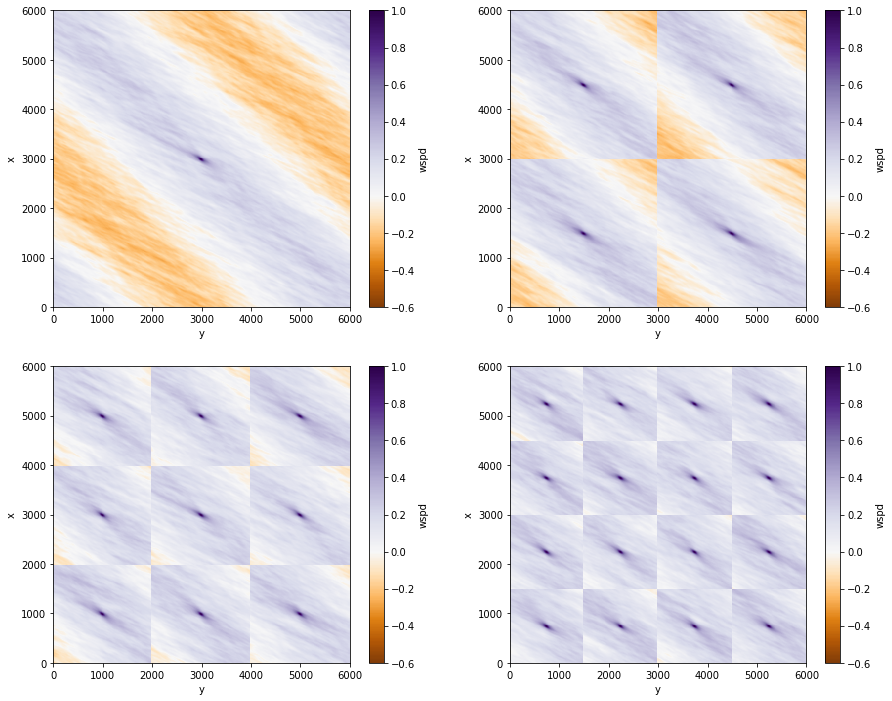

In [21]:
fig, axs= plt.subplots(nrows=2, ncols=2, figsize=(15,12))
axs=axs.flatten()
vmin=-0.6;  vmax=1
norm = mpl.colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
                               
v1x1original.mean(dim='datetime').wspd.plot(ax=axs[0], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
v2x2original.mean(dim='datetime').wspd.plot(ax=axs[1], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
v3x3original.mean(dim='datetime').wspd.plot(ax=axs[2], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
v4x4original.mean(dim='datetime').wspd.plot(ax=axs[3], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')

for ax in axs:
    ax.set_ylim([0, 6000])
    ax.set_xlim([0, 6000])
    ax.set_aspect('equal', 'box')

## Temporal autocorrelation visualization: original data

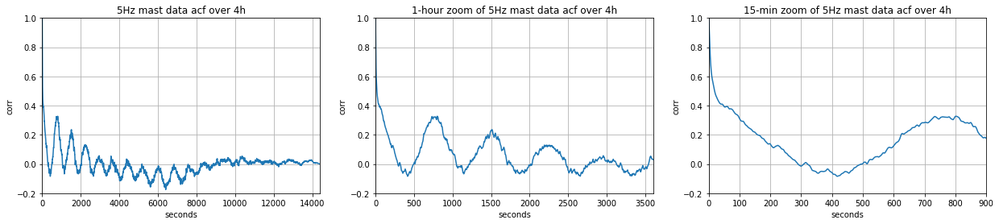

In [22]:
# (0,0) mast time-series
ti_dt =   pd.to_datetime(133200,   unit='s', origin=dateref)
tf4h_dt = pd.to_datetime(133200+ 4*3600, unit='s', origin=dateref)

wspd_5Hz = dssowfa.sel(datetime=slice(ti_dt, tf4h_dt),x=0,y=0,height=85).wspd  # shape 3600*4*5 = 72000
times_5Hz = np.arange(0, 3600*4, 0.2)[:-1] # shape 72000
acf_wspd_5Hz = acf(wspd_5Hz, nlags=3600*5*4, fft=True)

fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_5Hz, acf_wspd_5Hz);  axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 4*3600]);   axs[0].set_title('5Hz mast data acf over 4h');
axs[1].plot(times_5Hz, acf_wspd_5Hz);  axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 5Hz mast data acf over 4h');
axs[2].plot(times_5Hz, acf_wspd_5Hz);  axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 5Hz mast data acf over 4h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid()

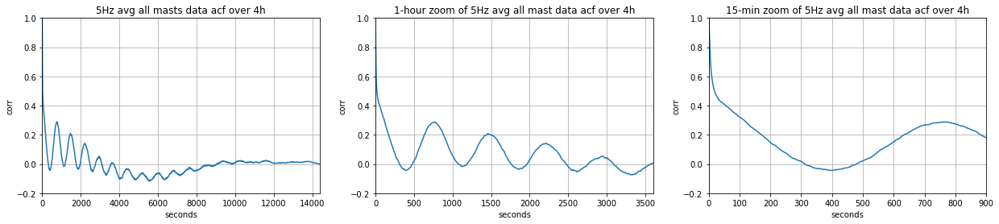

In [23]:
# all masts average time-series (smoother version of the plots above)

cum_acf_wspd_5Hz=[]
for i in range(5):
    for j in range(5):
        wspd_5Hz = dssowfa.isel(x=i, y=j).sel(datetime=slice(ti_dt, tf4h_dt),height=85).wspd  # shape 3600*4*5 = 72000
        times_5Hz = np.arange(0, 3600*4, 0.2)[:-1] # shape 72000
        acf_wspd_5Hz = acf(wspd_5Hz, nlags=3600*5*4, fft=True)
        cum_acf_wspd_5Hz.append(acf_wspd_5Hz)

fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_5Hz, np.mean(cum_acf_wspd_5Hz, axis=0));  axs[0].set_xlim([0, 4*3600]);   axs[0].set_title('5Hz avg all masts data acf over 4h');
axs[1].plot(times_5Hz, np.mean(cum_acf_wspd_5Hz, axis=0));  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 5Hz avg all mast data acf over 4h');
axs[2].plot(times_5Hz, np.mean(cum_acf_wspd_5Hz, axis=0));  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 5Hz avg all mast data acf over 4h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds');  ax.set_ylim([-0.2, 1]);  ax.grid()


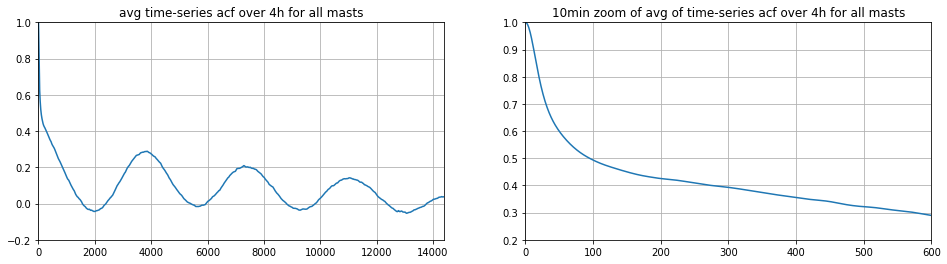

In [24]:
# all mast time-series
cum_acf_timeseries=[]
for i in range(5):
    for j in range(5):
        timeseries_1Hz = dssowfa.isel(x=i, y=j).sel(datetime=slice(pd.to_datetime(133200, unit='s', origin=dateref), pd.to_datetime(133200+3600*4, unit='s', origin=dateref)),height=85).wspd
        acf_timeseries = acf(timeseries_1Hz, nlags=3600*4, fft=True)
        cum_acf_timeseries.append(acf_timeseries)

fig, axs = plt.subplots(ncols=2, figsize=(16,4))
axs[0].plot(np.mean(cum_acf_timeseries, axis=0));  axs[0].set_ylim([-0.2, 1]);   axs[0].set_xlim([0, 4*3600]); axs[0].set_title('avg time-series acf over 4h for all masts'); axs[0].grid()
axs[1].plot(np.mean(cum_acf_timeseries, axis=0));  axs[1].set_ylim([0.2, 1]); axs[1].set_xlim([0, 600]);    axs[1].set_title('10min zoom of avg of time-series acf over 4h for all masts'); axs[1].grid()

From the plot above we can see the clear frequency and wave size of the gravity waves. We can curve-fit and get the frequency of that sine.

In [25]:
# Function to fit a sine curve
# from https://stackoverflow.com/questions/16716302/how-do-i-fit-a-sine-curve-to-my-data-with-pylab-and-numpy/42322656#42322656

def fit_sin(tt, yy):
    '''Fit sin to the input time sequence, and return fitting parameters "amp", "omega", "phase", "offset", "freq", "period" and "fitfunc"'''
    import scipy.optimize
    
    tt = np.array(tt)
    yy = np.array(yy)
    ff = np.fft.fftfreq(len(tt), (tt[1]-tt[0]))   # assume uniform spacing
    Fyy = abs(np.fft.fft(yy))
    guess_freq = abs(ff[np.argmax(Fyy[1:])+1])   # excluding the zero frequency "peak", which is related to offset
    guess_amp = np.std(yy) * 2.**0.5
    guess_offset = np.mean(yy)
    guess = np.array([guess_amp, 2.*np.pi*guess_freq, 0., guess_offset])

    def sinfunc(t, A, w, p, c):  return A * np.sin(w*t + p) + c
    popt, pcov = scipy.optimize.curve_fit(sinfunc, tt, yy, p0=guess)
    A, w, p, c = popt
    f = w/(2.*np.pi)
    fitfunc = lambda t: A * np.sin(w*t + p) + c
    return {"amp": A, "omega": w, "phase": p, "offset": c, "freq": f, "period": 1./f, "fitfunc": fitfunc, "maxcov": np.max(pcov), "rawres": (guess,popt,pcov)}

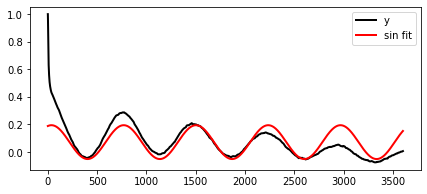

 omega: 0.008578 rad/s 
 phase: 1.257 rad 
 frequency: 0.001365 Hz 
 period: 732.51 s


In [26]:
# Let's get only the first hour of correlations
data = np.mean(cum_acf_wspd_5Hz, axis=0)[0:3600*5]
t = times_5Hz[0:3600*5]
res = fit_sin(t, data)

_, ax = plt.subplots(figsize=(7,3))
ax.plot(t, data, '-k', label='y', linewidth=2)
ax.plot(t, res['fitfunc'](t), 'r-', label='sin fit', linewidth=2); ax.legend(loc="best")
plt.show()

print(f' omega: {res["omega"]:.6f} rad/s \n phase: {res["phase"]:.3f} rad \n frequency: {res["freq"]:.6f} Hz \n period: {res["period"]:.2f} s')

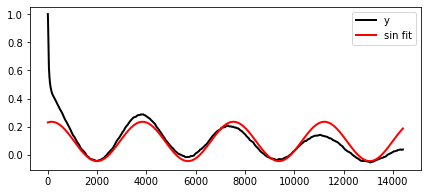

 omega: 0.001704 rad/s 
 phase: 1.311 rad 
 frequency: 0.000271 Hz 
 period: 3686.68 s


In [27]:
data = np.mean(cum_acf_timeseries, axis=0)
t = np.arange(len(data))
res = fit_sin(t, data)

_, ax = plt.subplots(figsize=(7,3))
ax.plot(t, data, '-k', label='y', linewidth=2)
ax.plot(t, res['fitfunc'](t), 'r-', label='sin fit', linewidth=2); ax.legend(loc="best")
plt.show()

print(f' omega: {res["omega"]:.6f} rad/s \n phase: {res["phase"]:.3f} rad \n frequency: {res["freq"]:.6f} Hz \n period: {res["period"]:.2f} s')

### Issues
The spatial correlation shows some clear "bands" in the solution. The temporal corelation shows a periodic pattern. 

- Those "bands" are not aligned with the mean wind direction. Shown below is a plot of an arbitrary 30-min window and the mean wind speed over the same period. Plotted is also the longitudinal and cross-flow directions of the mean wind diretion and the eye-balled direction of the correlation.

- Note that the spatial correlation does not drop to about zero far from the central point. It tends to hover aroud the 0.2 value.

- Temporal correlation of the original data shows an identifiable frequency where these waves are occuring

Therefore, we cannot really use the data that is "contaminated" by the gravity waves for correlation studies. The gravity waves, however, appear to be easily represented by a cosine function and can potentially be estimated and removed from the flowfield

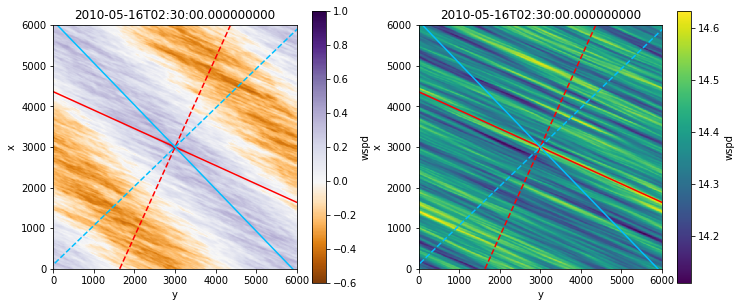

In [28]:
x0=3000
y0=3000

d=v1x1original.datetime[9]

# get mean wdir over interval
wdir = ds80m['wdir'].sel(datetime=slice(d,d+pd.to_timedelta(window,unit='s'))).mean().values
# estimate corrdir
corrdir = 316

# Define points along the streamwise direction going through (x0, y0)
xxlongitudinal = np.arange(0, 6000, 10)
a = -np.tan(np.deg2rad(wdir-90))
b = y0 - a*x0
yylongitudinal = a*xxlongitudinal + b

# Define points along the transverse flow directions, going through (x0, y0)
yytransverse = np.arange(0, 6000, 10)
a =  np.tan(np.deg2rad(360-wdir))
b = y0 - a*x0
xxtransverse = (yytransverse -b)/a


# Define points along the streamwise direction going through (x0, y0)
xxlon = np.arange(0, 6000, 10)
a = -np.tan(np.deg2rad(corrdir-90))
b = y0 - a*x0
yylon = a*xxlon + b

# Define points along the transverse flow directions, going through (x0, y0)
yytran = np.arange(0, 6000, 10)
a =  np.tan(np.deg2rad(360-corrdir))
b = y0 - a*x0
xxtran = (yytran -b)/a


fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(12,5), gridspec_kw={'hspace': 0.4})
vmin=-0.6;  vmax=1
norm = mpl.colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)

v1x1original.sel(datetime=slice(d,d+pd.to_timedelta(window,unit='s'))).mean(dim='datetime').wspd.plot(ax=axs[0], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
ds80m.sel(datetime=slice(d,d+pd.to_timedelta(window,unit='s'))).mean(dim='datetime').wspd.plot(ax=axs[1], cmap='viridis')

for ax in axs:
    ax.plot(xxlongitudinal, yylongitudinal, 'red');  
    ax.plot(xxtransverse, yytransverse, '--', color='red');      
    ax.plot(xxlon, yylon, 'deepskyblue');  
    ax.plot(xxtran, yytran,'--', color='deepskyblue');   
    ax.set_title(d.values);                      
    ax.set_ylim([0, 6000]);                      
    ax.set_xlim([0, 6000]);                      
    ax.set_aspect('equal', 'box');               
plt.show()

Looking at a few instantaneous snapshots, we can see that those bands appear to be related to the gravity waves that are passing through the domain.

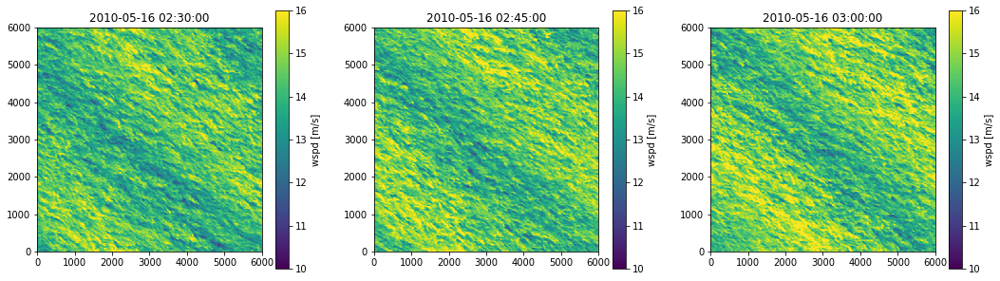

In [29]:
# showing some instantaneous slices
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(18,5))

currds = ds80m.sel(datetime='2010-05-16T02:30:00.00')
p = axs[0].pcolormesh(currds.x, currds.y, currds.wspd, vmin=10, vmax=16, cmap='viridis', shading='auto')
fig.colorbar(p,ax=axs[0], label='wspd [m/s]');  axs[0].set_title(pd.to_datetime(currds.datetime.values))

currds = ds80m.sel(datetime='2010-05-16T02:45:00.00')
p = axs[1].pcolormesh(currds.x, currds.y, (currds.u**2 + currds.v**2)**0.5, vmin=10, vmax=16, cmap='viridis', shading='auto')
fig.colorbar(p,ax=axs[1], label='wspd [m/s]');  axs[1].set_title(pd.to_datetime(currds.datetime.values))

currds = ds80m.sel(datetime='2010-05-16T03:00:00.00')
p = axs[2].pcolormesh(currds.x, currds.y, (currds.u**2 + currds.v**2)**0.5, vmin=10, vmax=16, cmap='viridis', shading='auto')
fig.colorbar(p,ax=axs[2], label='wspd [m/s]');  axs[2].set_title(pd.to_datetime(currds.datetime.values))

for ax in axs:
    ax.set_xlim([0,6000]);  ax.set_ylim([0,6000]);  ax.set_aspect('equal', 'box')

## Identifying the form of the gravity waves

Ok, now let's assume that the mean wind speed with the gravity wave is the same mean wind speed without it. That is, the g.w. disturbs the mean flow around the same mean. This is needed if we want to "remove" the g.w. from the overall combined flowfield. We will do this for every instant, so the mean flow will be the space-mean for every instant. This is contrasted by the plots above, where the mean flow plotted is a time-average for all points in space.

Now let's create our sine-based flowfield that will be removed from the instantaneous snapshot shown above. The field will be approximated by a sine function of the following form
\begin{equation}
U(x,y) =A \sin \left[ \omega \left( \tan (\text{corr}_\text{dir}) x + y \right) + \phi  \right]
\end{equation}

where $\omega$ is the frequency in rad/s, $A$ is the amplitude, and $\phi$ is the phase.

Plotting a flowfield following the equation above just to see if the cosine is ballpark in the right direction and matches the instantaneous plots above.

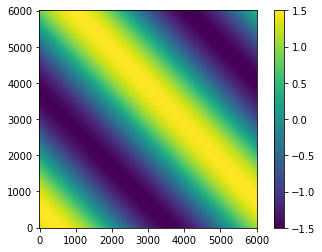

In [30]:
x = np.arange(0, 6001, 10)
y = np.arange(0, 6001, 10)
X, Y = np.meshgrid(x,y)
#omega=res['freq']*wspdmean.values # 0.0038
#omega=0.00027*4
omega=0.001
A=1.5
#corrdir=316
#tan = np.tan(np.deg2rad(360-corrdir))
tan=0.97
phase=np.pi/3
z = A*np.sin(omega*(tan*Y+X)+phase)

fig, ax = plt.subplots()
p = ax.pcolormesh(x, y, z, shading='auto')
fig.colorbar(p, ax=ax)
ax.set_aspect('equal', 'box')
plt.show()


Let's perform the curve fitting on one instant and see how the corrected flowfield looks like

In [31]:
# Define curve-fitting function type and aux variables
from scipy.optimize import curve_fit

def func(x, omega, A, phase, corrdir):
    tancorr = np.tan(np.deg2rad(360-corrdir))
    return A*np.sin(omega*(tancorr*x[1]+x[0])+phase)

x = np.arange(0, 6001, 10)
y = np.arange(0, 6001, 10)
X, Y = np.meshgrid(x,y)
size = X.shape
x_1d = X.reshape((1, np.prod(size)))
y_1d = Y.reshape((1, np.prod(size)))

xdata = np.vstack((x_1d, y_1d))

fitted parameters (omega, A, phase, corrDir): [1.04308620e-03 6.55818322e-01 4.36301884e+00 3.14797091e+02]


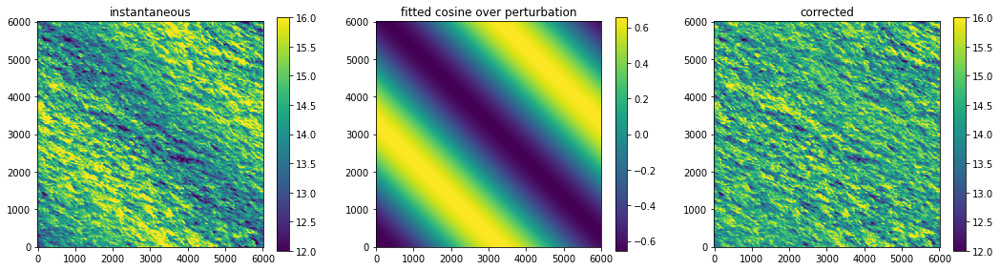

In [32]:
instantaneous = ds80m.sel(datetime='2010-05-16T03:01:01.00').wspd

Z_noise = np.array(instantaneous - instantaneous.mean() )
z_noise = Z_noise.reshape((361201,))

ydata = z_noise
popt, pcov = curve_fit(func, xdata, ydata, p0=(0.001, 2, 0.75*np.pi, 315), bounds=((0.0009,0.1, 0, 280), (0.002, 10, 2*np.pi, 350)) )
#                                                          ^
#                                                         Change this value to 0.2 and the fitted cosine is no longer a good fit.
#                                                         Sometimes the optimizer gets lost and we see those discontinuities on the omega/amp/phase plots
print(f'fitted parameters (omega, A, phase, corrDir): {popt}')

z_fit = func(xdata, *popt)
Z_fit = z_fit.reshape(size)

fig, axs = plt.subplots(ncols=3, figsize=(18,4.5))
axs[0].set_title("instantaneous")
p = axs[0].pcolormesh(X, Y, instantaneous, vmin=12, vmax=16, shading='auto')
axs[0].set_aspect('equal', 'box'); fig.colorbar(p, ax=axs[0])

axs[1].set_title("fitted cosine over perturbation")
p = axs[1].pcolormesh(X, Y, Z_fit, shading='auto')
axs[1].set_aspect('equal', 'box'); fig.colorbar(p, ax=axs[1])

axs[2].set_title("corrected")
p = axs[2].pcolormesh(X, Y, instantaneous-Z_fit, vmin=12, vmax=16, shading='auto')
axs[2].set_aspect('equal', 'box'); fig.colorbar(p, ax=axs[2])

plt.show()



It worked really well, but it appears to be highly dependent on a good initial guess for accurate convergence. For example, in the cell above, change the initial guess of the phase to $0.2\pi$.

Let's now do a loop over the whole period every minute and see how the fitting parameters vary.


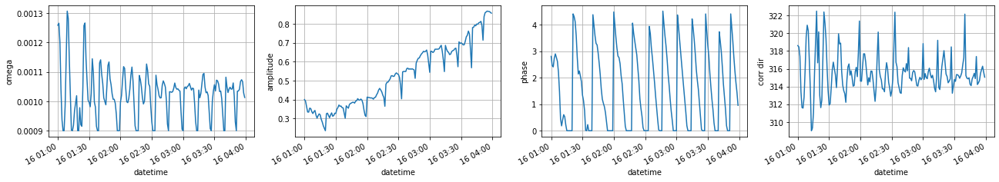

In [33]:
times = pd.date_range(start=pd.to_datetime(ds80m.datetime[0].values), end=pd.to_datetime(ds80m.datetime[-1].values), freq='1min')

test = ds80m.sel(datetime=times).copy()
test['cosfit'] = test['wdir']

omega=[];  A=[];  phase=[]; corrDir=[]

for t in test.datetime:
    currds = ds80m.sel(datetime=t)

    Z_noise = np.array(currds.wspd - currds.wspd.mean() )
    z_noise = Z_noise.reshape((361201,))

    popt, pcov = curve_fit(func, xdata, z_noise, p0=(0.001, 2, np.pi/2, 315), bounds=((0.0009,0.1, 0, 305), (0.002, 5, 2*np.pi, 325)) )

    z_fit = func(xdata, *popt)
    Z_fit = z_fit.reshape(size)
    
    test['cosfit'].loc[dict(datetime=t)] = Z_fit
    omega.append(popt[0]);  A.append(popt[1]);  phase.append(popt[2]);  corrDir.append(popt[3])
    

test['omega'] = (('datetime'), omega)
test['amplitude'] = (('datetime'), A)
test['phase'] = (('datetime'), phase)
test['corrDir'] = (('datetime'), corrDir)

fig, axs = plt.subplots(ncols=4, figsize=(22,3.5))
axs[0].plot(test['datetime'], test['omega']);      axs[0].set_ylabel('omega');      axs[0].set_xlabel('datetime');  axs[0].grid()
axs[1].plot(test['datetime'], test['amplitude']);  axs[1].set_ylabel('amplitude');  axs[1].set_xlabel('datetime');  axs[1].grid()
axs[2].plot(test['datetime'], test['phase']);      axs[2].set_ylabel('phase');      axs[2].set_xlabel('datetime');  axs[2].grid()
axs[3].plot(test['datetime'], test['corrDir']);    axs[3].set_ylabel('corr dir');   axs[3].set_xlabel('datetime');  axs[3].grid()
fig.autofmt_xdate()
plt.show()


As we can see from the plots above, the cosine fit for some time steps do not converge properly. The parameters should be smooth and not have the discontinuities shown, since the flowfield shows continuous gravity waves without any sort of abrupt change. 

I have tried the following, without success:
- For minute-to-minute data, instead of giving a fixed initial guess, use the previous converged parameters as the initial guess for the following time step.
- Doing the same as above, but on a second-by-second basis, instead of every minute.

The idea for trying the second higher frequency approach is that maybe the flowfield was varying in a significant way within the minute and thus would no longer converge. None of these worked and we spare the plots. The parameters tend to "converge" to the actual bounds giving and thus we obtain parameters that are dependent on the bounds, which is clearly incorrect.

With that said, I played with a constant initial guess that seemed to work well for all times. By working well I mean there is no discontinuity on the frequency, amplitude, phase, or correlation direction plots. The lack of discontinuity is further verified by seeing an animation of the actual and corrected flowfield. Also note that the value is never the actual bound I give.

Therefore, after trial-and-error, the initial guess that works best for this entire time period is
- Angular frequency $\omega$: 0.001 rad/s
- Amplitude: 1m/s
- Phase $\phi$: $0.75 \pi$
- correlation direction: 315 degrees (northwest)

## Create/Read corrected flowfield

Now that we have identified the best initial guess, let's perform the procedure for all times and add to the dataset so we don't need to run this everytime.

In [34]:
if os.path.isfile(os.path.join(procdatadir, 'ds_VTK80m_01Z_04Z_sowfa_complete.nc')):
    ds80m_corrected = xr.open_dataset(os.path.join(procdatadir, 'ds_VTK80m_01Z_04Z_sowfa_complete.nc'))
else:
    
    ds80m['cosfit'] = ds80m['wdir'].copy()
    omega=[];  A=[];  phase=[]; corrDir=[]

    for t in ds80m.datetime:
        print(f'Processing {pd.to_datetime(t.values)}', end='\r', flush=True)
        currds = ds80m.sel(datetime=t)

        Z_noise = np.array(currds.wspd - currds.wspd.mean() )
        #z_noise = Z_noise.reshape((361201,))
        z_noise = np.hstack(Z_noise)

        popt, pcov = curve_fit(func, xdata, z_noise, p0=(0.001, 2, 0.75*np.pi, 315), bounds=((0.0009,0.1, -np.pi, 305), (0.002, 5, 2*np.pi, 325)) )

        z_fit = func(xdata, *popt)
        Z_fit = z_fit.reshape(size)

        ds80m['cosfit'].loc[dict(datetime=t)] = Z_fit
        omega.append(popt[0]);  A.append(popt[1]);  phase.append(popt[2]);  corrDir.append(popt[3])

    ds80m['omega'] = (('datetime'), omega);  ds80m['amplitude'] = (('datetime'), A)
    ds80m['phase'] = (('datetime'), phase);  ds80m['corrDir'] = (('datetime'), corrDir)

    ds80m_corrected.to_netcdf(os.path.join(procdatadir, 'ds_VTK80m_01Z_04Z_sowfa_complete.nc'))

Let's see the parameters of the fitted cosine

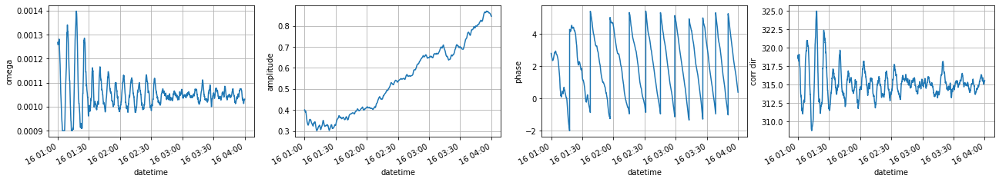

In [35]:
fig, axs = plt.subplots(ncols=4, figsize=(22,3.5))
axs[0].plot(ds80m_corrected['datetime'], ds80m_corrected['omega']);      axs[0].set_ylabel('omega');      axs[0].set_xlabel('datetime');  axs[0].grid()
axs[1].plot(ds80m_corrected['datetime'], ds80m_corrected['amplitude']);  axs[1].set_ylabel('amplitude');  axs[1].set_xlabel('datetime');  axs[1].grid()
axs[2].plot(ds80m_corrected['datetime'], ds80m_corrected['phase']);      axs[2].set_ylabel('phase');      axs[2].set_xlabel('datetime');  axs[2].grid()
axs[3].plot(ds80m_corrected['datetime'], ds80m_corrected['corrDir']);    axs[3].set_ylabel('corr dir');   axs[3].set_xlabel('datetime');  axs[3].grid()
fig.autofmt_xdate(); plt.show()

### Visualize the corrected flowfield
Jupyter notebook becomes too large if this animation is saved alongside it. So the output isn't shown here for space reasons. Change the `frames` argument on line 32 to 180 for an animation of 3 hours of data every minute

In [36]:
x = ds80m_corrected.x    
y = ds80m_corrected.y
wspd = ds80m_corrected.isel(datetime=0).wspd
cosfit = ds80m_corrected.isel(datetime=0).cosfit
wspd_nogw = wspd - cosfit

fig, axs = plt.subplots(ncols=3, figsize=(21, 5)) 

p1 = axs[0].pcolormesh(x,y,wspd,  vmin=12, vmax=16, shading='auto')
cb1 = fig.colorbar(p1,ax=axs[0], label='wspd [m/s]'); axs[0].set_title(f'instantaneous')

p2 = axs[1].pcolormesh(x,y,cosfit, vmin=-0.8, vmax=0.8, shading='auto')
cb2 = fig.colorbar(p2, ax=axs[1], label='wspd [m/s]'); axs[1].set_title(f'fitted cosine over perturbation')

p3 = axs[2].pcolormesh(x,y,wspd_nogw,  vmin=12, vmax=16, cmap='viridis', shading='auto')
cb3 = fig.colorbar(p3,ax=axs[2], label='wspd [m/s]'); axs[2].set_title(f'corrected')
    
for ax in axs:  ax.set_xlim([0,6000]);  ax.set_ylim([0,6000]);  ax.set_aspect('equal', 'box');  ax.axis('off')
    
    
def animate(i):
    wspd = ds80m_corrected.isel(datetime=60*i).wspd.values
    cosfit = ds80m_corrected.isel(datetime=60*i).cosfit.values
    wspd_nogv = wspd - cosfit
    
    p1.set_array(wspd.ravel())
    p2.set_array(cosfit.ravel())
    p3.set_array(wspd_nogv.ravel())
    fig.suptitle(f'{pd.to_datetime(ds80m_corrected.isel(datetime=60*i).datetime.values)}')
    return

anim = animation.FuncAnimation(fig,animate,frames=30,interval=150,blit=False,repeat=False)

# To get only the animation
plt.close()

from IPython.display import HTML
HTML(anim.to_jshtml())

# Spatial correlation: corrected data
Let's perform the same procedure on the corrected data

In [37]:
# Re-organize the dataset
ds80m_corrected['wspd_corr'] = ds80m_corrected['wspd'] - ds80m_corrected['cosfit']

In [38]:
# Parameters
ti=133200
tf=133200+3*3600
window=1800
inc=600 # marching of the window (controls overlap)

In [39]:
# Entire domain
if os.path.isfile(os.path.join(procdatadir, 'correlation1x1subdom_30min_complete.nc')):
    v1x1complete = xr.open_dataset(os.path.join(procdatadir, 'correlation1x1subdom_30min_complete.nc'))
else:
    v1x1complete = performCorrelationSubDomain(ds80m_corrected[['wspd','wspd_corr']], 1, 1, outputnc='correlation1x1subdom_30min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

# 2x2 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation2x2subdom_30min_complete.nc')):
    v2x2complete = xr.open_dataset(os.path.join(procdatadir, 'correlation2x2subdom_30min_complete.nc'))
else:
    v2x2complete = performCorrelationSubDomain(ds80m_corrected[['wspd','wspd_corr']], 2, 2, outputnc='correlation2x2subdom_30min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

# 3x3 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation3x3subdom_30min_complete.nc')):
    v3x3complete = xr.open_dataset(os.path.join(procdatadir, 'correlation3x3subdom_30min_complete.nc'))
else:
    v3x3complete = performCorrelationSubDomain(ds80m_corrected[['wspd','wspd_corr']], 3, 3, outputnc='correlation3x3subdom_30min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)
    
# 4x4 sub-domain
if os.path.isfile(os.path.join(procdatadir, 'correlation4x4subdom_30min_complete.nc')):
    v4x4complete = xr.open_dataset(os.path.join(procdatadir, 'correlation4x4subdom_30min_complete.nc'))
else:
    v4x4complete = performCorrelationSubDomain(ds80m_corrected[['wspd','wspd_corr']], 4, 4, outputnc='correlation4x4subdom_30min_complete.nc', ti=ti, tf=tf, window=window, inc=inc)

## Spatial correlation visualization: corrected data
Now the correlation is aligned with the mean wind direction, as it should

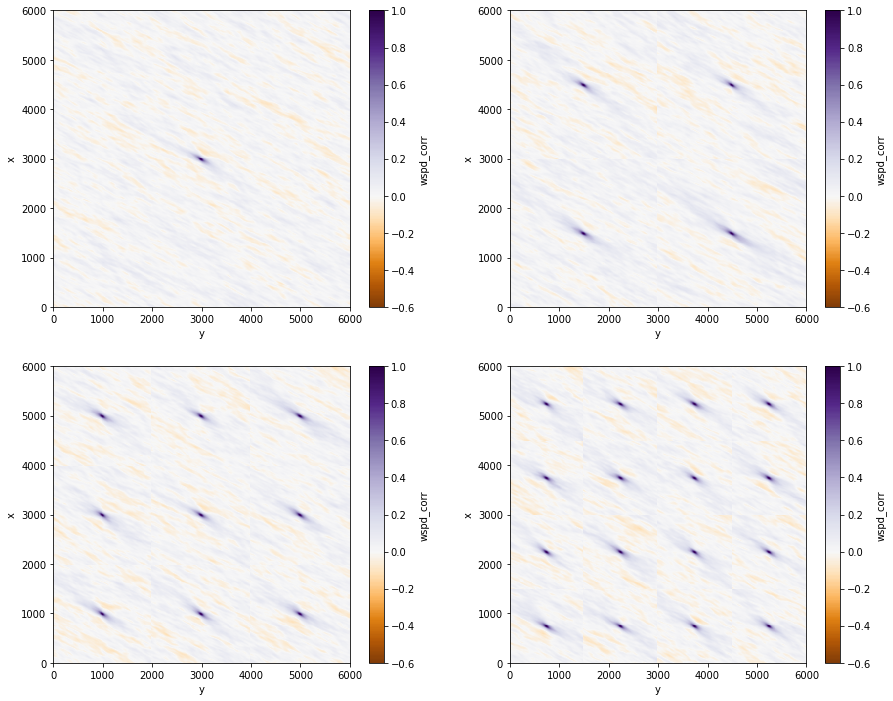

In [40]:
fig, axs= plt.subplots(nrows=2, ncols=2, figsize=(15,12))
axs=axs.flatten()
vmin=-0.6;  vmax=1
norm = mpl.colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
                               
v1x1complete.mean(dim='datetime').wspd_corr.plot(ax=axs[0], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
v2x2complete.mean(dim='datetime').wspd_corr.plot(ax=axs[1], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
v3x3complete.mean(dim='datetime').wspd_corr.plot(ax=axs[2], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
v4x4complete.mean(dim='datetime').wspd_corr.plot(ax=axs[3], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')

for ax in axs:
    ax.set_ylim([0, 6000])
    ax.set_xlim([0, 6000])
    ax.set_aspect('equal', 'box')

Let's see if the resulting correlation now is actually aligned with the flowfield. For that, let's see the corrected and uncorrected data. Just is just a sanity-check to know that when we get the along-flow correlation, we are indeed getting along the correlation.

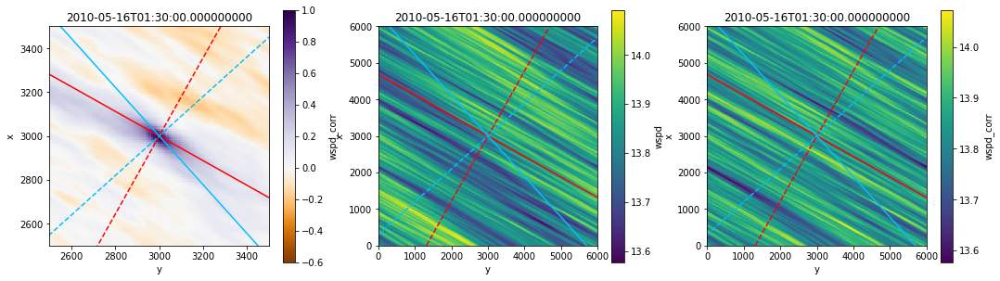

In [41]:
x0=3000
y0=3000

d=v1x1complete.datetime[3]

# get mean wdir over interval
wdir = ds80m_corrected['wdir'].sel(datetime=slice(d,d+pd.to_timedelta(window,unit='s'))).mean().values
# estimate corrdir
corrdir = 318

# Define points along the streamwise direction going through (x0, y0)
xxlongitudinal = np.arange(0, 6000, 10)
a = -np.tan(np.deg2rad(wdir-90));  b = y0 - a*x0
yylongitudinal = a*xxlongitudinal + b

# Define points along the transverse flow directions, going through (x0, y0)
yytransverse = np.arange(0, 6000, 10)
a =  np.tan(np.deg2rad(360-wdir));  b = y0 - a*x0
xxtransverse = (yytransverse -b)/a

# Define points along the streamwise direction going through (x0, y0)
xxlon = np.arange(0, 6000, 10)
a = -np.tan(np.deg2rad(corrdir-90));  b = y0 - a*x0
yylon = a*xxlon + b

# Define points along the transverse flow directions, going through (x0, y0)
yytran = np.arange(0, 6000, 10)
a =  np.tan(np.deg2rad(360-corrdir));  b = y0 - a*x0
xxtran = (yytran -b)/a


fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(18,5), gridspec_kw={'hspace': 0.4})
vmin=-0.6;  vmax=1
norm = mpl.colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)

v1x1complete.sel(datetime=slice(d,d+pd.to_timedelta(window,unit='s'))).mean(dim='datetime').wspd_corr.plot(ax=axs[0], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
ds80m_corrected.sel(datetime=slice(d,d+pd.to_timedelta(window,unit='s'))).mean(dim='datetime').wspd.plot(ax=axs[1], cmap='viridis')
ds80m_corrected.sel(datetime=slice(d,d+pd.to_timedelta(window,unit='s'))).mean(dim='datetime').wspd_corr.plot(ax=axs[2], cmap='viridis')

for ax in axs:
    ax.plot(xxlongitudinal, yylongitudinal, 'red');  
    ax.plot(xxtransverse, yytransverse, '--', color='red');      
    ax.plot(xxlon, yylon, 'deepskyblue');  
    ax.plot(xxtran, yytran,'--', color='deepskyblue');   
    ax.set_title(d.values);                      
    ax.set_ylim([0, 6000]);                      
    ax.set_xlim([0, 6000]);                      
    ax.set_aspect('equal', 'box');     
axs[0].set_ylim([2500, 3500]);                      
axs[0].set_xlim([2500, 3500]); 
plt.show()

## Spatial correlation: plotting wind-aligned spatially-averaged correlations based on corrected flowfield

In [42]:
# Get values from plots above along the mean wind direction
spaceCorr1x1 = getSpaceCorrAlongWindDir( ds80m_corrected, v1x1complete, nSubDomainsX=1, nSubDomainsY=1 )
spaceCorr2x2 = getSpaceCorrAlongWindDir( ds80m_corrected, v2x2complete, nSubDomainsX=2, nSubDomainsY=2 )
spaceCorr3x3 = getSpaceCorrAlongWindDir( ds80m_corrected, v3x3complete, nSubDomainsX=3, nSubDomainsY=3 )
spaceCorr4x4 = getSpaceCorrAlongWindDir( ds80m_corrected, v4x4complete, nSubDomainsX=4, nSubDomainsY=4 )

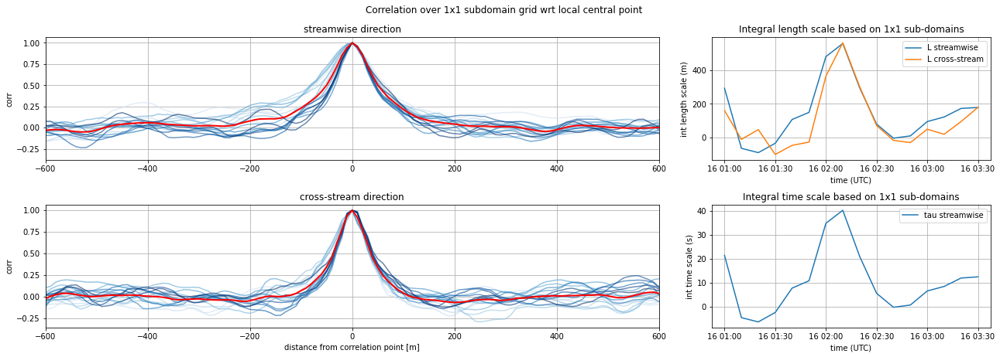

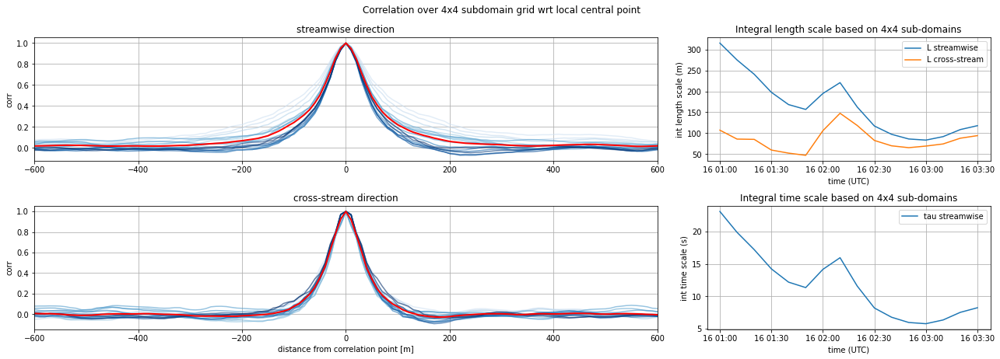

In [43]:
plotCorrelationCurves(vcomplete=v1x1complete, spaceCorr = spaceCorr1x1, title='1x1', xlim=[-600, 600])
#plotCorrelationCurves(vcomplete=v2x2complete, spaceCorr = spaceCorr2x2, title='2x2', xlim=[-600, 600])
#plotCorrelationCurves(vcomplete=v3x3complete, spaceCorr = spaceCorr3x3, title='3x3', xlim=[-600, 600])
plotCorrelationCurves(vcomplete=v4x4complete, spaceCorr = spaceCorr4x4, title='4x4', xlim=[-600, 600])

The integral time scale above is simply based on the computed integral length scale and the mean windpeed at that interval, thus the trends are similar. The 1x1 domain has higher variance because we are not averaging in space. So let's focus on the 4x4 domain.

Let's get the length scale of an ellipse around a constant correlation value

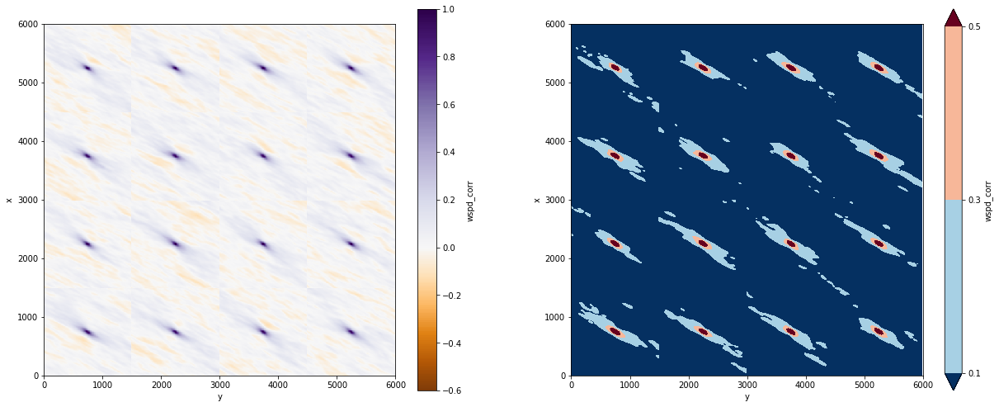

In [44]:
fig, axs= plt.subplots(ncols=2, figsize=(21,8.5))
vmin=-0.6;  vmax=1
norm = mpl.colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
                               
v4x4complete.mean(dim='datetime').wspd_corr.plot(ax=axs[0], vmin=vmin, vmax=vmax, norm=norm, cmap='PuOr')
v4x4complete.mean(dim='datetime').wspd_corr.plot.contourf(ax=axs[1], levels=[ 0.1, 0.3, 0.5])


for ax in axs:
    ax.set_ylim([0, 6000])
    ax.set_xlim([0, 6000])
    ax.set_aspect('equal', 'box')

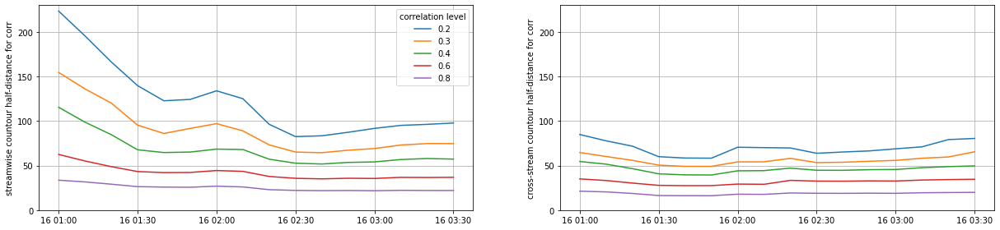

In [45]:
corrList=[0.2,0.3,0.4,0.6,0.8]
a=np.zeros([16, len(corrList)])
b=np.zeros([16, len(corrList)])

for c, corr in enumerate(corrList):
    for t in range(16):
        longarr = np.split(spaceCorr4x4['v_long'][t],2)[0]
        tranarr = np.split(spaceCorr4x4['v_tran'][t],2)[0]
        longx = np.split(spaceCorr4x4['x_long'],2)[0]
        tranx = np.split(spaceCorr4x4['x_tran'],2)[0]
        
        idlong = np.abs(longarr - corr).argmin()
        idtran = np.abs(tranarr - corr).argmin()
        #print(f'level {corr}, time {t}: pos long: {idlong}, id tran: {idtran}')
        
        a[t,c] = np.abs(np.interp(corr, longarr[idlong-2:idlong+2], longx[idlong-2:idlong+2]))
        b[t,c] = np.abs(np.interp(corr, tranarr[idtran-2:idtran+2], tranx[idtran-2:idtran+2]))
        
        
        
fig, axs = plt.subplots(ncols=2, figsize=(17, 4))
for c, corr in enumerate(corrList):
    axs[0].plot(v4x4complete.datetime, a[:,c], label=corr)
    axs[1].plot(v4x4complete.datetime, b[:,c], label=corr)

axs[0].set_ylabel('streamwise countour half-distance for corr')
axs[1].set_ylabel('cross-stream countour half-distance for corr')
axs[0].legend(title='correlation level')

for ax in axs: ax.grid(); ax.set_ylim([0,230])

plt.tight_layout()
fig.subplots_adjust(wspace=0.2)
plt.show()

# Temporal autocorrelation

In [46]:
# Specify times
ti = 133200
tf3h = ti+ 3*3600
tf4h = ti+ 4*3600

ti_dt =   pd.to_datetime(ti,   unit='s', origin=dateref)
tf3h_dt = pd.to_datetime(tf3h, unit='s', origin=dateref)
tf4h_dt = pd.to_datetime(tf4h, unit='s', origin=dateref)

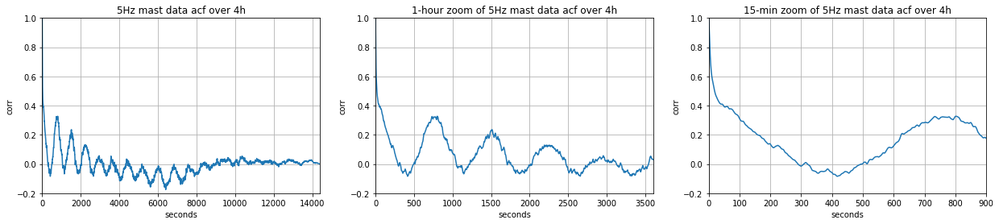

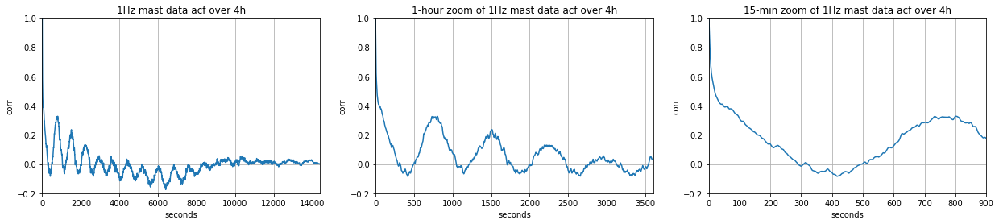

In [47]:
# (0,0) mast time-series

itimes = np.arange(4,71999, 5)

wspd_5Hz = dssowfa.sel(datetime=slice(ti_dt, tf4h_dt),x=0,y=0,height=85).wspd  # shape 3600*4*5 = 72000
times_5Hz = np.arange(0, 3600*4, 0.2)[:-1] # shape 72000

wspd_1Hz = dssowfa.sel(datetime=slice(ti_dt, tf4h_dt),x=0,y=0,height=85).isel(datetime=itimes).wspd  # shape 3600*4 = 14400
times_1Hz = np.arange(0, 3600*4, 1)[:-1]  # 14400

acf_wspd_5Hz = acf(wspd_5Hz, nlags=3600*5*4, fft=True)
acf_wspd_1Hz = acf(wspd_1Hz, nlags=3600*1*4, fft=True)

fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_5Hz, acf_wspd_5Hz);  axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 4*3600]);   axs[0].set_title('5Hz mast data acf over 4h');
axs[1].plot(times_5Hz, acf_wspd_5Hz);  axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 5Hz mast data acf over 4h');
axs[2].plot(times_5Hz, acf_wspd_5Hz);  axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 5Hz mast data acf over 4h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid()

fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_1Hz, acf_wspd_1Hz);  axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 4*3600]);   axs[0].set_title('1Hz mast data acf over 4h');
axs[1].plot(times_1Hz, acf_wspd_1Hz);  axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 1Hz mast data acf over 4h');
axs[2].plot(times_1Hz, acf_wspd_1Hz);  axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 1Hz mast data acf over 4h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid()

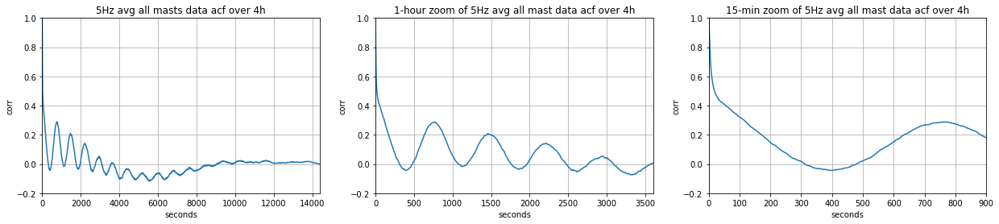

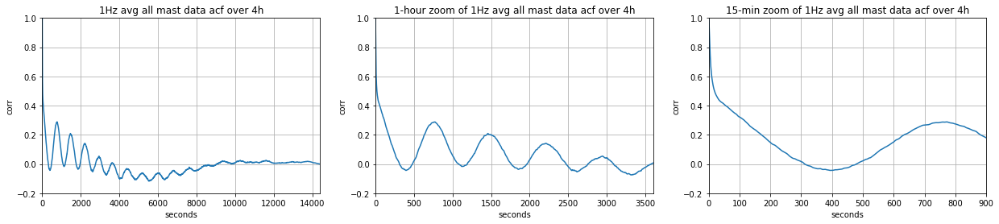

In [48]:
# all masts average time-series (smoother version of the plots above)

cum_acf_wspd_1Hz=[]
cum_acf_wspd_5Hz=[]
for i in range(5):
    for j in range(5):
        itimes = np.arange(4,71999, 5)

        wspd_5Hz = dssowfa.isel(x=i, y=j).sel(datetime=slice(ti_dt, tf4h_dt),height=85).wspd  # shape 3600*4*5 = 72000
        times_5Hz = np.arange(0, 3600*4, 0.2)[:-1] # shape 72000

        wspd_1Hz = dssowfa.isel(x=i, y=j).sel(datetime=slice(ti_dt, tf4h_dt),height=85).isel(datetime=itimes).wspd  # shape 3600*4 = 14400
        times_1Hz = np.arange(0, 3600*4, 1)[:-1]  # 14400

        acf_wspd_5Hz = acf(wspd_5Hz, nlags=3600*5*4, fft=True)
        acf_wspd_1Hz = acf(wspd_1Hz, nlags=3600*1*4, fft=True)

        cum_acf_wspd_5Hz.append(acf_wspd_5Hz)
        cum_acf_wspd_1Hz.append(acf_wspd_1Hz)

cum_acf_wspd_5Hz = np.mean(cum_acf_wspd_5Hz, axis=0);
cum_acf_wspd_1Hz = np.mean(cum_acf_wspd_1Hz, axis=0);
        
fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_5Hz, cum_acf_wspd_5Hz);  axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 4*3600]);   axs[0].set_title('5Hz avg all masts data acf over 4h');
axs[1].plot(times_5Hz, cum_acf_wspd_5Hz);  axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 5Hz avg all mast data acf over 4h');
axs[2].plot(times_5Hz, cum_acf_wspd_5Hz);  axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 5Hz avg all mast data acf over 4h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid()

fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_1Hz, cum_acf_wspd_1Hz);  axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 4*3600]);   axs[0].set_title('1Hz avg all mast data acf over 4h');
axs[1].plot(times_1Hz, cum_acf_wspd_1Hz);  axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 1Hz avg all mast data acf over 4h');
axs[2].plot(times_1Hz, cum_acf_wspd_1Hz);  axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 1Hz avg all mast data acf over 4h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid()

Now for a 3 hour long time series. Let's see how they change

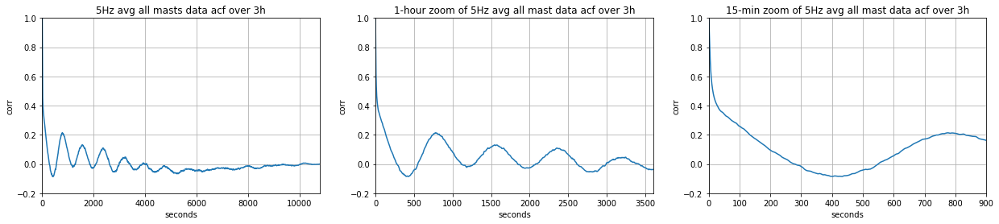

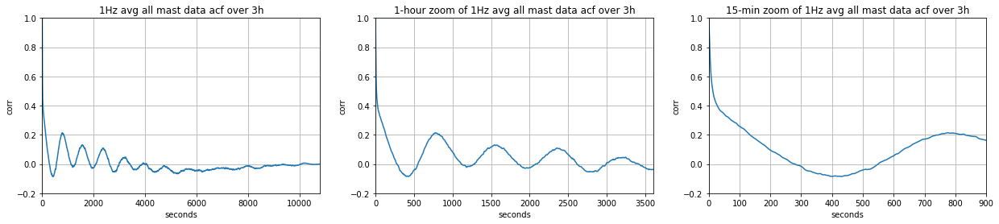

In [49]:
# all masts average time-series (smoother version of the plots above)

cum_acf_wspd_1Hz=[]
cum_acf_wspd_5Hz=[]
for i in range(5):
    for j in range(5):
        itimes = np.arange(4,53999, 5)

        wspd_5Hz = dssowfa.isel(x=i, y=j).sel(datetime=slice(ti_dt, tf3h_dt),height=85).wspd  # shape 3600*3*5 = 54000
        times_5Hz = np.arange(0, 3600*3, 0.2) # shape 72000

        wspd_1Hz = dssowfa.isel(x=i, y=j).sel(datetime=slice(ti_dt, tf3h_dt),height=85).isel(datetime=itimes).wspd  # shape 3600*3 = 10800
        times_1Hz = np.arange(0, 3600*3, 1)[:-1]  # shape 10800

        acf_wspd_5Hz = acf(wspd_5Hz, nlags=3600*5*3, fft=True)
        acf_wspd_1Hz = acf(wspd_1Hz, nlags=3600*1*3, fft=True)

        cum_acf_wspd_5Hz.append(acf_wspd_5Hz)
        cum_acf_wspd_1Hz.append(acf_wspd_1Hz)

cum_acf_wspd_5Hz = np.mean(cum_acf_wspd_5Hz, axis=0);
cum_acf_wspd_1Hz = np.mean(cum_acf_wspd_1Hz, axis=0);
        
fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_5Hz, cum_acf_wspd_5Hz);  axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 3*3600]);   axs[0].set_title('5Hz avg all masts data acf over 3h');
axs[1].plot(times_5Hz, cum_acf_wspd_5Hz);  axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 5Hz avg all mast data acf over 3h');
axs[2].plot(times_5Hz, cum_acf_wspd_5Hz);  axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 5Hz avg all mast data acf over 3h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid()

fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_1Hz, cum_acf_wspd_1Hz);  axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 3*3600]);   axs[0].set_title('1Hz avg all mast data acf over 3h');
axs[1].plot(times_1Hz, cum_acf_wspd_1Hz);  axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 1Hz avg all mast data acf over 3h');
axs[2].plot(times_1Hz, cum_acf_wspd_1Hz);  axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 1Hz avg all mast data acf over 3h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid()

### Re-doing the above with data from VTK
It is not going to be exactly the same because the mast data is at 85m and the VTK is at 80m, but they should be fairly similar

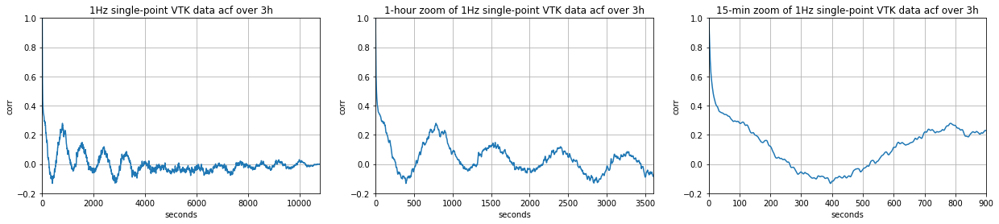

In [50]:
# single-point VTK time-series

wspd_1Hz = ds80m_corrected[['wspd','wspd_corr']].isel(x=300, y=300).sel(datetime=slice(ti_dt, tf3h_dt)).wspd  # shape 3600*3 = 10800
times_1Hz = np.arange(0, 3600*3, 1)#[:-1]  # 10800

acf_wspd_1Hz = acf(wspd_1Hz, nlags=3600*1*4, fft=True)

fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_1Hz, acf_wspd_1Hz);  axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 3*3600]);   axs[0].set_title('1Hz single-point VTK data acf over 3h');
axs[1].plot(times_1Hz, acf_wspd_1Hz);  axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 1Hz single-point VTK data acf over 3h');
axs[2].plot(times_1Hz, acf_wspd_1Hz);  axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 1Hz single-point VTK data acf over 3h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid()

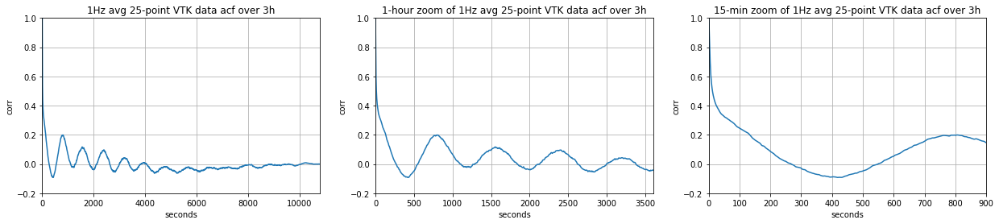

In [51]:
# 25 locations average time-series (smoother version of the plots above)

cum_acf_wspd_1Hz=[]
for i in np.arange(100, 501, 100):
    for j in np.arange(100, 501, 100):
        wspd_1Hz = ds80m_corrected[['wspd','wspd_corr']].isel(x=i, y=j).sel(datetime=slice(ti_dt, tf3h_dt)).wspd  # shape 3600*3 = 10800
        times_1Hz = np.arange(0, 3600*3, 1)#[:-1]  # shape 10800
        acf_wspd_1Hz = acf(wspd_1Hz, nlags=3600*1*3, fft=True)

        cum_acf_wspd_1Hz.append(acf_wspd_1Hz)

cum_acf_wspd_1Hz = np.mean(cum_acf_wspd_1Hz, axis=0);

fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_1Hz, cum_acf_wspd_1Hz);  axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 3*3600]);   axs[0].set_title('1Hz avg 25-point VTK data acf over 3h');
axs[1].plot(times_1Hz, cum_acf_wspd_1Hz);  axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 1Hz avg 25-point VTK data acf over 3h');
axs[2].plot(times_1Hz, cum_acf_wspd_1Hz);  axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 1Hz avg 25-point VTK data acf over 3h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid()

## Temporal autocorrelation of the corrected flowfield
Now that we know that we are getting the same mast-equivalent wind speed, let's do with the corrected flowfield

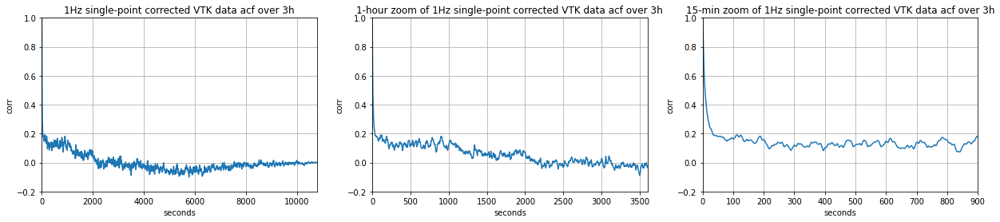

In [52]:
# single-point corrected VTK time-series

wspd_corr_1Hz = ds80m_corrected[['wspd','wspd_corr']].isel(x=300, y=300).sel(datetime=slice(ti_dt, tf3h_dt)).wspd_corr  # shape 3600*3 = 10800
times_corr_1Hz = np.arange(0, 3600*3, 1)#[:-1]  # 10800

acf_wspd_corr_1Hz = acf(wspd_corr_1Hz, nlags=3600*1*4, fft=True)

fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_corr_1Hz, acf_wspd_corr_1Hz);  axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 3*3600]);   axs[0].set_title('1Hz single-point corrected VTK data acf over 3h');
axs[1].plot(times_corr_1Hz, acf_wspd_corr_1Hz);  axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 1Hz single-point corrected VTK data acf over 3h');
axs[2].plot(times_corr_1Hz, acf_wspd_corr_1Hz);  axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 1Hz single-point corrected VTK data acf over 3h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid()

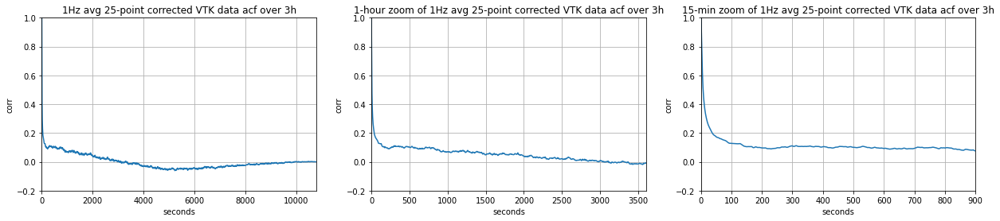

In [53]:
# 25 locations average time-series of the corrected flowfield

cum_acf_wspd_corr_1Hz=[]
for i in np.arange(100, 501, 100):
    for j in np.arange(100, 501, 100):
        wspd_1Hz = ds80m_corrected[['wspd','wspd_corr']].isel(x=i, y=j).sel(datetime=slice(ti_dt, tf3h_dt)).wspd_corr  # shape 3600*3 = 10800
        times_1Hz = np.arange(0, 3600*3, 1)#[:-1]  # shape 10800
        acf_wspd_corr_1Hz = acf(wspd_1Hz, nlags=3600*1*3, fft=True)

        cum_acf_wspd_corr_1Hz.append(acf_wspd_corr_1Hz)

cum_acf_wspd_corr_1Hz = np.mean(cum_acf_wspd_corr_1Hz, axis=0);

fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_1Hz, cum_acf_wspd_corr_1Hz);  axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 3*3600]);   axs[0].set_title('1Hz avg 25-point corrected VTK data acf over 3h');
axs[1].plot(times_1Hz, cum_acf_wspd_corr_1Hz);  axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 1Hz avg 25-point corrected VTK data acf over 3h');
axs[2].plot(times_1Hz, cum_acf_wspd_corr_1Hz);  axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 1Hz avg 25-point corrected VTK data acf over 3h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid()

## Temporal autocorrelation of observation data

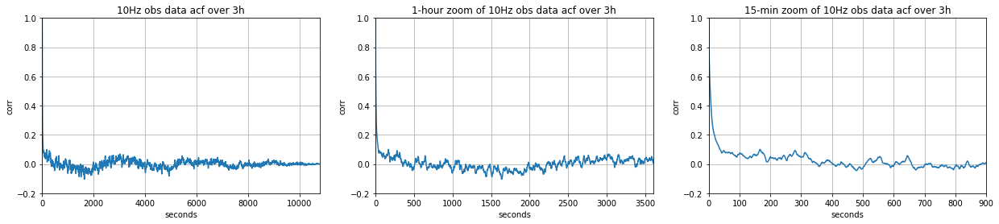

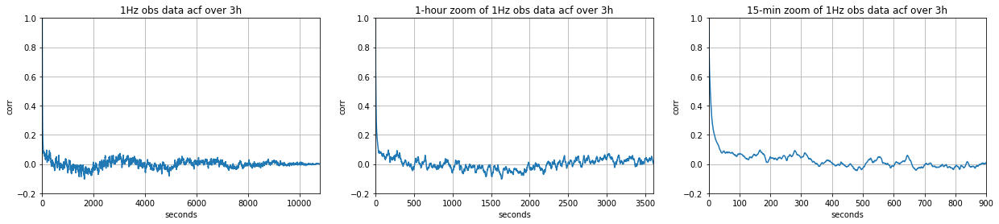

In [54]:
# single-point 3-hour obs time-series

itimes = np.arange(0,107999, 10)  # shape 10800

wspd_obs_10Hz = obs.sel(datetime=slice(ti_dt, tf3h_dt),height=80).wspd[:-1]  # shape 3600*3*10 = 108000
times_obs_10Hz = np.arange(0, 3600*3, 0.1)#[:-1] # shape 72000

wspd_obs_1Hz = obs.sel(datetime=slice(ti_dt, tf3h_dt),height=80).isel(datetime=itimes).wspd  # shape 3600*4 = 14400
times_obs_1Hz = np.arange(0, 3600*3, 1)#[:-1]  # 14400

acf_wspd_obs_10Hz = acf(wspd_obs_10Hz, nlags=3600*10*3, fft=True)
acf_wspd_obs_1Hz = acf(wspd_obs_1Hz, nlags=3600*1*3,  fft=True)

fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_obs_10Hz, acf_wspd_obs_10Hz);  axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 3*3600]);   axs[0].set_title('10Hz obs data acf over 3h');
axs[1].plot(times_obs_10Hz, acf_wspd_obs_10Hz);  axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 10Hz obs data acf over 3h');
axs[2].plot(times_obs_10Hz, acf_wspd_obs_10Hz);  axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 10Hz obs data acf over 3h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid()

fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_obs_1Hz, acf_wspd_obs_1Hz);  axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 3*3600]);   axs[0].set_title('1Hz obs data acf over 3h');
axs[1].plot(times_obs_1Hz, acf_wspd_obs_1Hz);  axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title('1-hour zoom of 1Hz obs data acf over 3h');
axs[2].plot(times_obs_1Hz, acf_wspd_obs_1Hz);  axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title('15-min zoom of 1Hz obs data acf over 3h');
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid()

### Temporal correlation comparison (3 hours of obs)

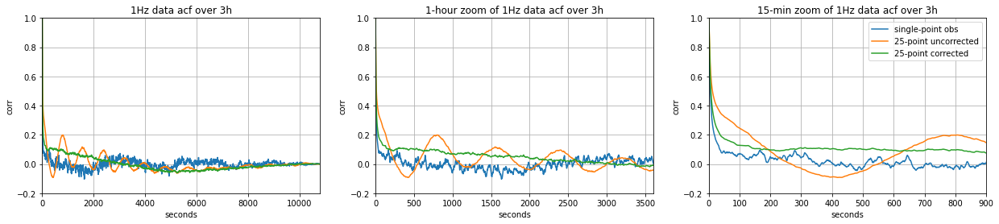

In [55]:
# Interval (lag) for the correction, in hours (max 3)
interval = 3

ti_dt = pd.to_datetime(133200,   unit='s', origin=dateref)
tf_dt = pd.to_datetime(133200 +interval*3600, unit='s', origin=dateref)


# 25-point uncorrected VTK data (1Hz)
cum_acf_wspd_1Hz=[]
for i in np.arange(100, 501, 100):
    for j in np.arange(100, 501, 100):
        wspd_1Hz = ds80m_corrected[['wspd','wspd_corr']].isel(x=i, y=j).sel(datetime=slice(ti_dt, tf_dt)).wspd  # shape 3600*3 = 10800
        times_1Hz = np.arange(0, 3600*interval, 1)#[:-1]  # shape 10800
        acf_wspd_1Hz = acf(wspd_1Hz, nlags=3600*1*interval, fft=True)

        cum_acf_wspd_1Hz.append(acf_wspd_1Hz)
cum_acf_wspd_1Hz = np.mean(cum_acf_wspd_1Hz, axis=0);



# 25-point corrected VTK data (1Hz)
cum_acf_wspd_corr_1Hz=[]
for i in np.arange(100, 501, 100):
    for j in np.arange(100, 501, 100):
        wspd_1Hz = ds80m_corrected[['wspd','wspd_corr']].isel(x=i, y=j).sel(datetime=slice(ti_dt, tf_dt)).wspd_corr  # shape 3600*3 = 10800
        times_1Hz = np.arange(0, 3600*interval, 1)#[:-1]  # shape 10800
        acf_wspd_corr_1Hz = acf(wspd_1Hz, nlags=3600*1*interval, fft=True)
        cum_acf_wspd_corr_1Hz.append(acf_wspd_corr_1Hz)
cum_acf_wspd_corr_1Hz = np.mean(cum_acf_wspd_corr_1Hz, axis=0);



# Single-point observation data (upsampled to 1Hz)
itimes = np.arange(0,interval*3600*10-1, 10, dtype=int)  # shape 10800
wspd_obs_1Hz = obs.sel(datetime=slice(ti_dt, tf_dt),height=80).isel(datetime=itimes).wspd  # shape 3600*4 = 14400
times_obs_1Hz = np.arange(0, 3600*interval, 1)#[:-1]  # 14400
acf_wspd_obs_1Hz = acf(wspd_obs_1Hz, nlags=3600*1*interval,  fft=True)


fig, axs = plt.subplots(ncols=3, figsize=(21,4)) 
axs[0].plot(times_obs_1Hz, acf_wspd_obs_1Hz);   axs[1].plot(times_obs_1Hz, acf_wspd_obs_1Hz);   axs[2].plot(times_obs_1Hz, acf_wspd_obs_1Hz, label='single-point obs'); 
axs[0].plot(times_1Hz, cum_acf_wspd_1Hz);       axs[1].plot(times_1Hz, cum_acf_wspd_1Hz);       axs[2].plot(times_1Hz, cum_acf_wspd_1Hz, label='25-point uncorrected'); 
axs[0].plot(times_1Hz, cum_acf_wspd_corr_1Hz);  axs[1].plot(times_1Hz, cum_acf_wspd_corr_1Hz);  axs[2].plot(times_1Hz, cum_acf_wspd_corr_1Hz,label='25-point corrected');

axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 3*3600]);   axs[0].set_title(f'1Hz data acf over {interval}h');
axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title(f'1-hour zoom of 1Hz data acf over {interval}h');
axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title(f'15-min zoom of 1Hz data acf over {interval}h');
axs[2].legend(loc='upper right')
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid();

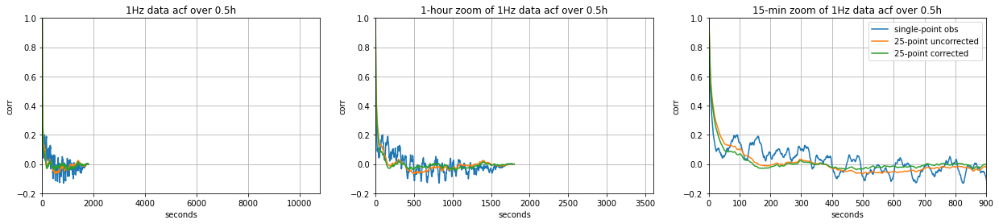

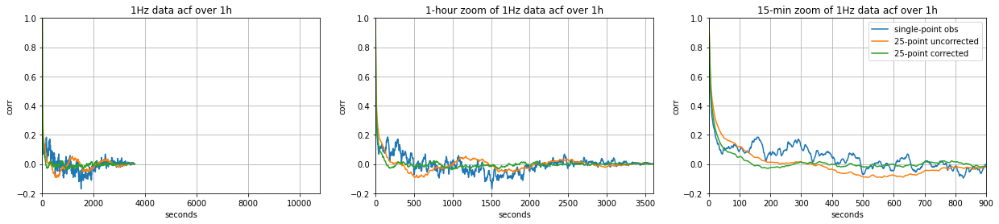

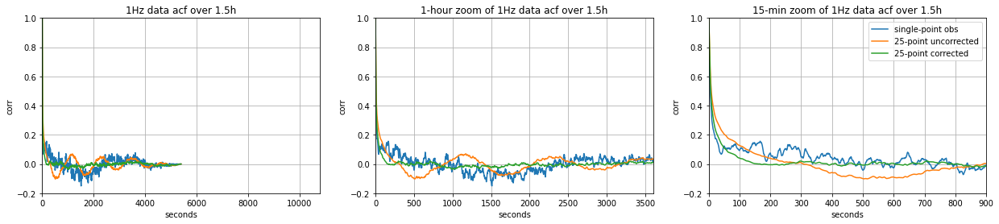

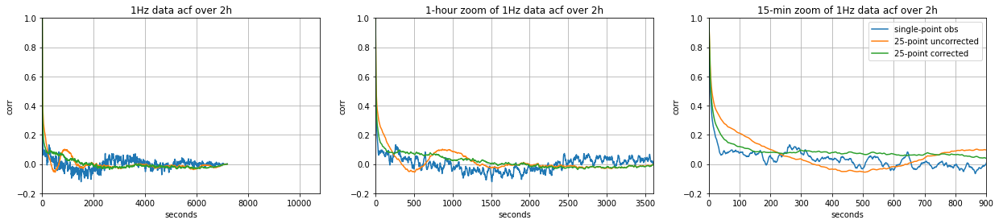

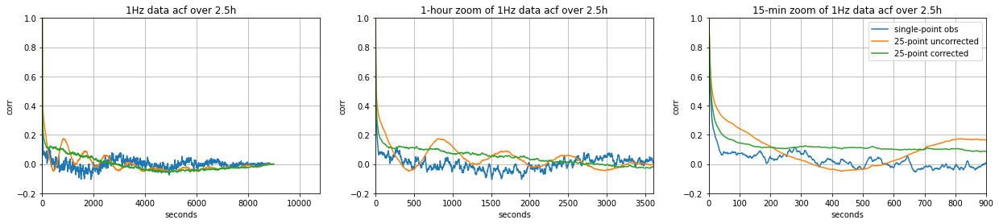

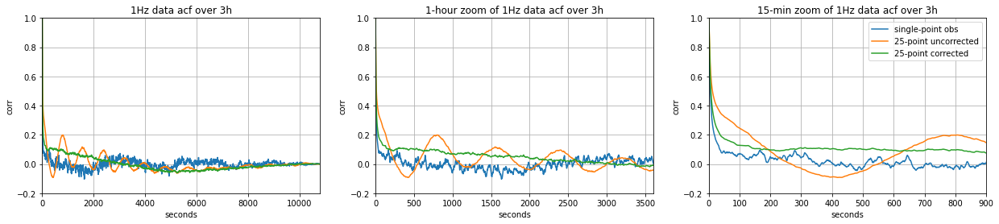

In [56]:
# Interval (lag) for the correction, in hours (max 3)
interval = 1.5

for interval in [0.5, 1, 1.5, 2, 2.5, 3]:
    ti_dt = pd.to_datetime(133200,   unit='s', origin=dateref)
    tf_dt = pd.to_datetime(133200 +interval*3600, unit='s', origin=dateref)

    # 25-point uncorrected VTK data (1Hz)
    cum_acf_wspd_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            wspd_1Hz = ds80m_corrected[['wspd','wspd_corr']].isel(x=i, y=j).sel(datetime=slice(ti_dt, tf_dt)).wspd  # shape 3600*3 = 10800
            times_1Hz = np.arange(0, 3600*interval, 1)#[:-1]  # shape 10800
            acf_wspd_1Hz = acf(wspd_1Hz, nlags=3600*1*interval, fft=True)

            cum_acf_wspd_1Hz.append(acf_wspd_1Hz)
    cum_acf_wspd_1Hz = np.mean(cum_acf_wspd_1Hz, axis=0);



    # 25-point corrected VTK data (1Hz)
    cum_acf_wspd_corr_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            wspd_1Hz = ds80m_corrected[['wspd','wspd_corr']].isel(x=i, y=j).sel(datetime=slice(ti_dt, tf_dt)).wspd_corr  # shape 3600*3 = 10800
            times_1Hz = np.arange(0, 3600*interval, 1)#[:-1]  # shape 10800
            acf_wspd_corr_1Hz = acf(wspd_1Hz, nlags=3600*1*interval, fft=True)
            cum_acf_wspd_corr_1Hz.append(acf_wspd_corr_1Hz)
    cum_acf_wspd_corr_1Hz = np.mean(cum_acf_wspd_corr_1Hz, axis=0);



    # Single-point observation data (upsampled to 1Hz)
    itimes = np.arange(0,interval*3600*10-1, 10, dtype=int)  # shape 10800
    wspd_obs_1Hz = obs.sel(datetime=slice(ti_dt, tf_dt),height=80).isel(datetime=itimes).wspd  # shape 3600*4 = 14400
    times_obs_1Hz = np.arange(0, 3600*interval, 1)#[:-1]  # 14400
    acf_wspd_obs_1Hz = acf(wspd_obs_1Hz, nlags=3600*1*interval,  fft=True)


    fig, axs = plt.subplots(ncols=3, figsize=(21,4))
    axs[0].plot(times_obs_1Hz, acf_wspd_obs_1Hz);   axs[1].plot(times_obs_1Hz, acf_wspd_obs_1Hz);   axs[2].plot(times_obs_1Hz, acf_wspd_obs_1Hz, label='single-point obs'); 
    axs[0].plot(times_1Hz, cum_acf_wspd_1Hz);       axs[1].plot(times_1Hz, cum_acf_wspd_1Hz);       axs[2].plot(times_1Hz, cum_acf_wspd_1Hz, label='25-point uncorrected'); 
    axs[0].plot(times_1Hz, cum_acf_wspd_corr_1Hz);  axs[1].plot(times_1Hz, cum_acf_wspd_corr_1Hz);  axs[2].plot(times_1Hz, cum_acf_wspd_corr_1Hz,label='25-point corrected'); 
    
    axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 3*3600]);   axs[0].set_title(f'1Hz data acf over {interval}h');
    axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title(f'1-hour zoom of 1Hz data acf over {interval}h');
    axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title(f'15-min zoom of 1Hz data acf over {interval}h');
    axs[2].legend(loc='upper right')
    for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid();

#### Temporal correlation comparison (4 hours of obs).

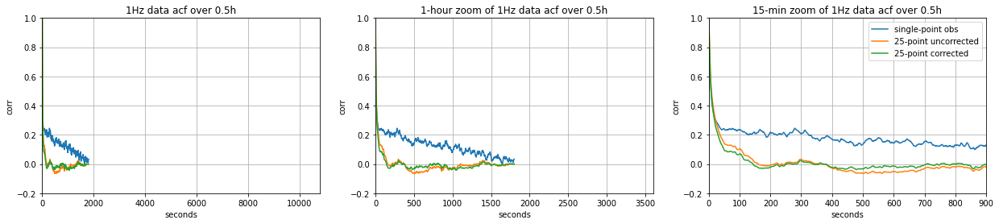

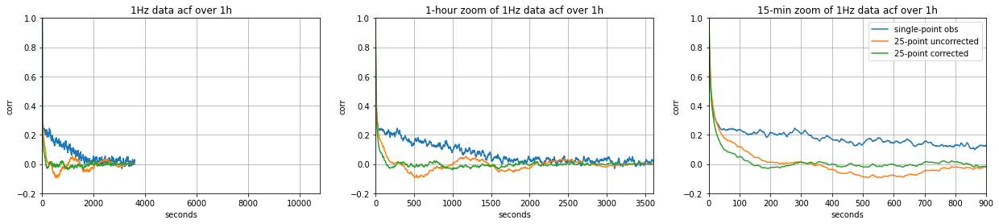

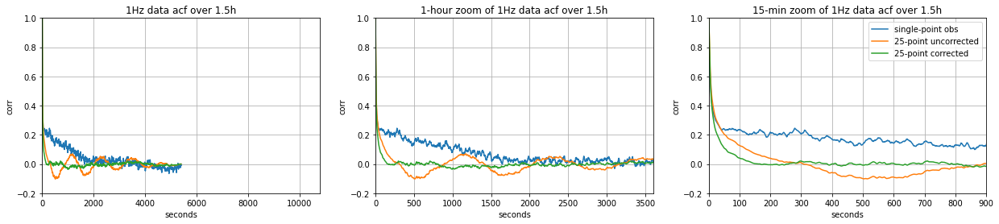

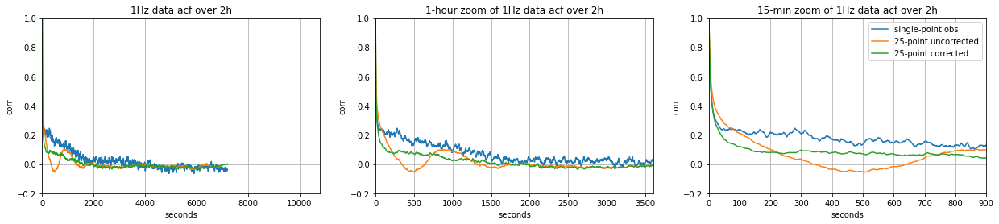

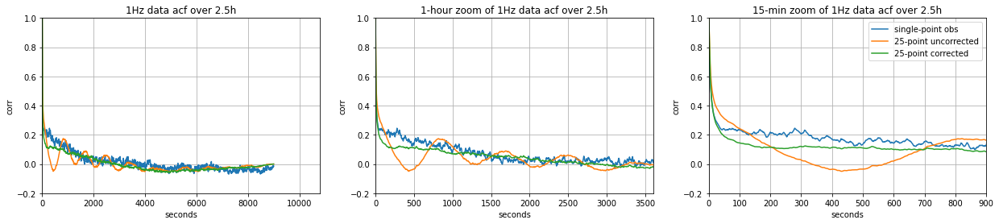

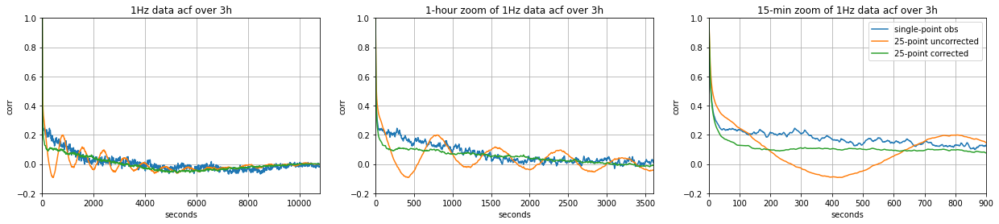

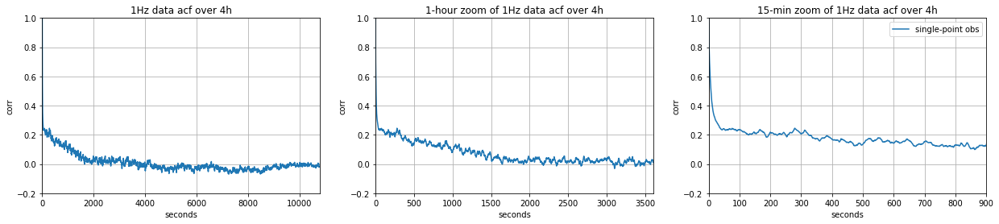

In [57]:
# using all four hours of obs

for interval in [0.5, 1, 1.5, 2, 2.5, 3]:
    ti_dt = pd.to_datetime(133200,   unit='s', origin=dateref)
    tf_dt = pd.to_datetime(133200 +interval*3600, unit='s', origin=dateref)

    # 25-point uncorrected VTK data (1Hz)
    cum_acf_wspd_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            wspd_1Hz = ds80m_corrected[['wspd','wspd_corr']].isel(x=i, y=j).sel(datetime=slice(ti_dt, tf_dt)).wspd  # shape 3600*3 = 10800
            times_1Hz = np.arange(0, 3600*interval, 1)#[:-1]  # shape 10800
            acf_wspd_1Hz = acf(wspd_1Hz, nlags=3600*1*interval, fft=True)

            cum_acf_wspd_1Hz.append(acf_wspd_1Hz)
    cum_acf_wspd_1Hz = np.mean(cum_acf_wspd_1Hz, axis=0);



    # 25-point corrected VTK data (1Hz)
    cum_acf_wspd_corr_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            wspd_1Hz = ds80m_corrected[['wspd','wspd_corr']].isel(x=i, y=j).sel(datetime=slice(ti_dt, tf_dt)).wspd_corr  # shape 3600*3 = 10800
            times_1Hz = np.arange(0, 3600*interval, 1)#[:-1]  # shape 10800
            acf_wspd_corr_1Hz = acf(wspd_1Hz, nlags=3600*1*interval, fft=True)
            cum_acf_wspd_corr_1Hz.append(acf_wspd_corr_1Hz)
    cum_acf_wspd_corr_1Hz = np.mean(cum_acf_wspd_corr_1Hz, axis=0);



    # Single-point observation data (upsampled to 1Hz)
    itimes = np.arange(0,4*3600*10-1, 10, dtype=int)  # shape 10800
    wspd_obs_1Hz = obs.sel(height=80).isel(datetime=itimes).wspd  # shape 3600*4 = 14400
    times_obs_1Hz = np.arange(0, 3600*interval, 1)#[:-1]  # 14400
    acf_wspd_obs_1Hz = acf(wspd_obs_1Hz, nlags=3600*1*interval,  fft=True)[:-1]


    fig, axs = plt.subplots(ncols=3, figsize=(21,4))
    axs[0].plot(times_obs_1Hz, acf_wspd_obs_1Hz);   axs[1].plot(times_obs_1Hz, acf_wspd_obs_1Hz);   axs[2].plot(times_obs_1Hz, acf_wspd_obs_1Hz, label='single-point obs');
    axs[0].plot(times_1Hz, cum_acf_wspd_1Hz);       axs[1].plot(times_1Hz, cum_acf_wspd_1Hz);       axs[2].plot(times_1Hz, cum_acf_wspd_1Hz, label='25-point uncorrected'); 
    axs[0].plot(times_1Hz, cum_acf_wspd_corr_1Hz);  axs[1].plot(times_1Hz, cum_acf_wspd_corr_1Hz);  axs[2].plot(times_1Hz, cum_acf_wspd_corr_1Hz,label='25-point corrected'); 

    axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 3*3600]);   axs[0].set_title(f'1Hz data acf over {interval}h');
    axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title(f'1-hour zoom of 1Hz data acf over {interval}h');
    axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title(f'15-min zoom of 1Hz data acf over {interval}h');
    axs[2].legend(loc='upper right')
    for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid();
        
        
        
interval=4
ti_dt = pd.to_datetime(133200,   unit='s', origin=dateref)
tf_dt = pd.to_datetime(133200 +interval*3600, unit='s', origin=dateref)

# Single-point observation data (upsampled to 1Hz)
itimes = np.arange(0,4*3600*10-1, 10, dtype=int)  # shape 10800
wspd_obs_1Hz = obs.sel(height=80).isel(datetime=itimes).wspd  # shape 3600*4 = 14400
times_obs_1Hz = np.arange(0, 3600*interval, 1)[:-1]  # 14400
acf_wspd_obs_1Hz = acf(wspd_obs_1Hz, nlags=3600*1*interval,  fft=True)[:-1]

fig, axs = plt.subplots(ncols=3, figsize=(21,4))
axs[0].plot(times_obs_1Hz, acf_wspd_obs_1Hz);   axs[1].plot(times_obs_1Hz, acf_wspd_obs_1Hz);   axs[2].plot(times_obs_1Hz, acf_wspd_obs_1Hz, label='single-point obs'); 

axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 3*3600]);   axs[0].set_title(f'1Hz data acf over {interval}h');
axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 1*3600]);   axs[1].set_title(f'1-hour zoom of 1Hz data acf over {interval}h');
axs[2].set_ylim([-0.2, 1]);  axs[2].set_xlim([0,0.25*3600]); axs[2].set_title(f'15-min zoom of 1Hz data acf over {interval}h');
axs[2].legend(loc='upper right')
for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid();

## After meeting May 28
Some potential things to change
- use only fluctuations on both obs and cfd data
- use the fluctuations around a rolling mean, not a global one (10min mean could be a good start)
- try to give a much smaller window with a much smaller lag (something like 15min and 1min; or even 5min and 1min). Play with it until it converges


### Getting fluctuations
The data vary in a significant way over the whole period, so the fluctuating data will be obtained from a rolling 10-min average.

Plotted below is just a sanity-check of:
- original obs 10Hz data
- the 1Hz up-sampled obs data
- their rolling means
- their 10-min average on the rolling mean

And finally,
- the obs fluctuating field

In [58]:
# 3 hours obs (so same time-history length I have for corrected VTK data)
itimes1Hz = np.arange(0,3*3600*10+1, 10, dtype=int)
obs1Hz = obs.isel(datetime=itimes1Hz)
obs1Hzmean = obs1Hz.rolling(datetime=600, min_periods=1).mean()
obs1Hz10minmean = obs1Hzmean.resample(datetime='10min').mean()

In [59]:
# Get rolling 10-min mean
obs10Hz = obs.isel(datetime=slice(0,3*3600*10+1))
obs10Hzmean = obs10Hz.rolling(datetime=6000, min_periods=1).mean()
obs10Hz10minmean = obs10Hzmean.resample(datetime='10min').mean()

In [60]:
# the actual fluctuating field. Doing it both ways so we can compare
obs1Hzfluc = obs1Hz-obs1Hzmean
obs1Hz10minfluc = obs1Hz - obs1Hz10minmean.resample(datetime='1s').nearest()

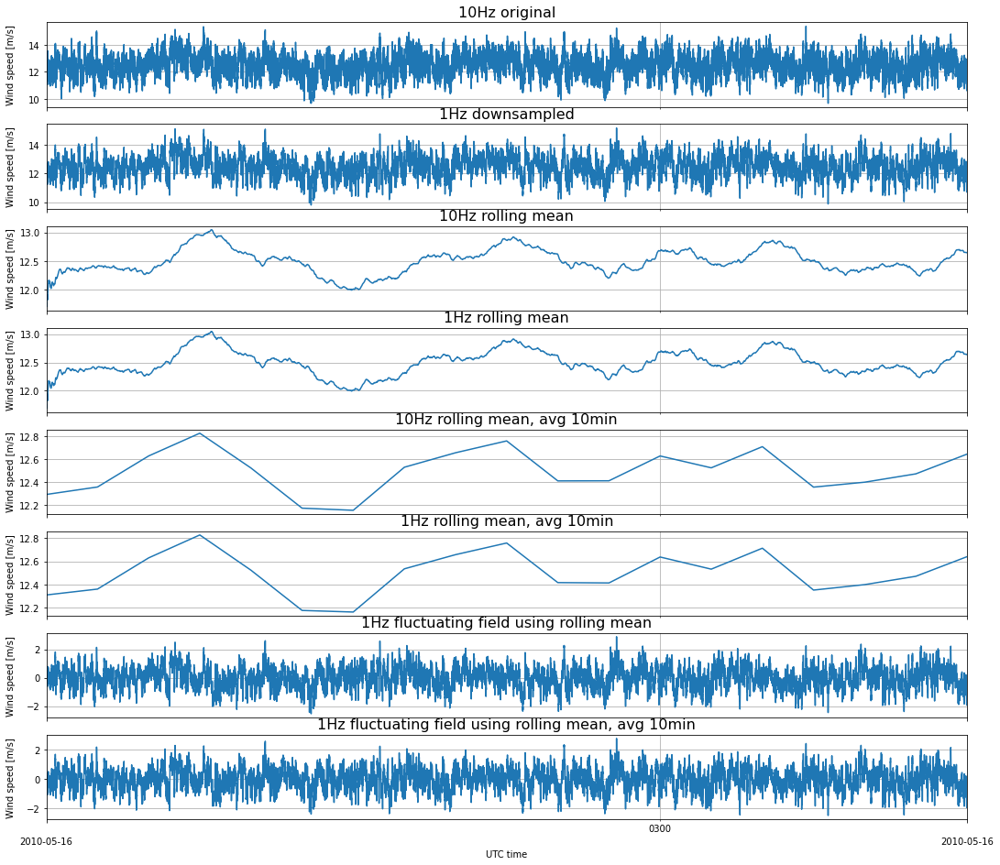

In [61]:
fig,ax = plot_timehistory_at_height(
    datasets={'10Hz original': obs10Hz,
              '1Hz downsampled': obs1Hz,
              '10Hz rolling mean':obs10Hzmean,
              '1Hz rolling mean':obs1Hzmean,
              '10Hz rolling mean, avg 10min':obs10Hz10minmean,
              '1Hz rolling mean, avg 10min': obs1Hz10minmean,
              '1Hz fluctuating field using rolling mean': obs1Hzfluc,
              '1Hz fluctuating field using rolling mean, avg 10min': obs1Hz10minfluc,
             },
    fields='wspd',heights=80,
    subfigsize=(18,2.0),
    timelimits=[LESfrom,LESto-pd.Timedelta(hours=1)],
    #timelimits=[pd.to_datetime('2010-05-16 01:15:00'),pd.to_datetime('2010-05-16 01:40:00')],
    stack_by_datasets=False)

The resulting fluctuating field are virtually the same. So I will use the one that uses the rolling mean (without a resampling of 10min avg).

Now let's do the same procedure with the corrected flowfield data and perform some temporal correlations. As far as they go, we know that:
- Given the same data chunk, the size of the lag doesn't change the solution (it only changes the length of the correlation--it will be correlated for the length of the lag)

Let's verify that below, using a 15-min interval and a 2-min lab

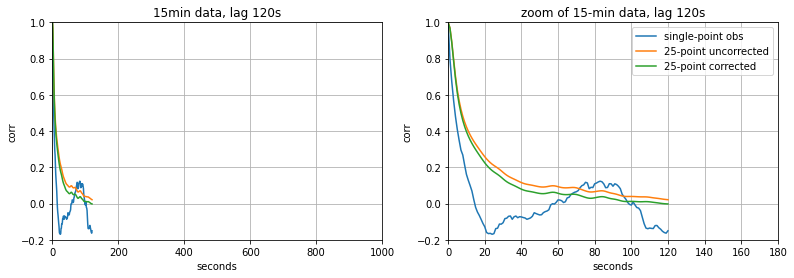

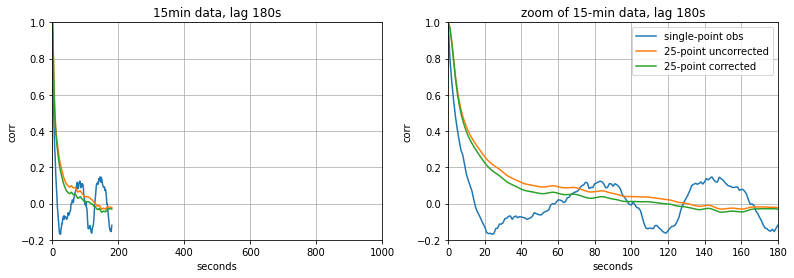

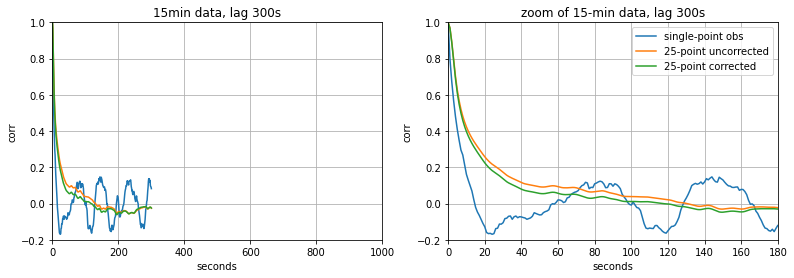

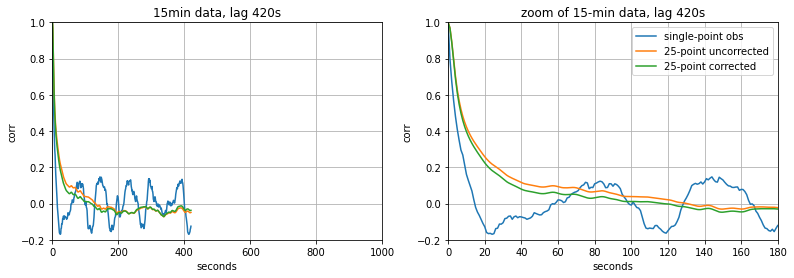

In [62]:
# if the same interval is given, the lag amount shouldn't change the solution-- this is shown here.
# Now, let's see the variation on size of data

interval = 900 # 15min
lag = 180 # 3min

for lag in [2*60, 3*60, 5*60, 7*60]:
    ti_dt = pd.to_datetime(133201,   unit='s', origin=dateref)
    tf_dt = pd.to_datetime(133200 +3*3600, unit='s', origin=dateref)

    # Window of data used (start and end)
    windowS = 0
    windowE = windowS + interval

    # 25-point uncorrected VTK data (1Hz)
    cum_acf_wspd_1Hz=[]
    wspd_1Hz_ = ds80m_corrected[['wspd']].sel(datetime=slice(ti_dt, tf_dt)).wspd
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspd_1Hz = wspd_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspd_1Hzmean = wspd_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspd_1Hzfluc = wspd_1Hz - wspd_1Hzmean
            # Get desired window
            wspd_1Hzfluc = wspd_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_1Hz = acf(wspd_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_1Hz.append(acf_wspd_1Hz)
    cum_acf_wspd_1Hz = np.mean(cum_acf_wspd_1Hz, axis=0);



    # 25-point corrected VTK data (1Hz)
    cum_acf_wspd_corr_1Hz=[]
    wspdcorr_1Hz_ = ds80m_corrected[['wspd_corr']].sel(datetime=slice(ti_dt, tf_dt)).wspd_corr
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspdcorr_1Hz = wspdcorr_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspdcorr_1Hzmean = wspdcorr_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspdcorr_1Hzfluc = wspdcorr_1Hz - wspdcorr_1Hzmean
            # Get desired window
            wspdcorr_1Hzfluc = wspdcorr_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_corr_1Hz = acf(wspdcorr_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_corr_1Hz.append(acf_wspd_corr_1Hz)
    cum_acf_wspd_corr_1Hz = np.mean(cum_acf_wspd_corr_1Hz, axis=0);



    # Single-point observation data (upsampled to 1Hz)
    wspd_obs_1Hz_ = obs1Hzfluc.sel(datetime=slice(ti_dt, tf_dt), height=80).wspd
    # Get desired window
    wspd_obs_1Hz = wspd_obs_1Hz_.isel(datetime=slice(windowS,windowE))
    # Create time array of length lag
    times_obs_1Hz = np.arange(0, lag+1, 1)
    # Compute autoccorelation
    acf_wspd_obs_1Hz = acf(wspd_obs_1Hz, nlags=lag,  fft=True)


    fig, axs = plt.subplots(ncols=2, figsize=(13,4))
    axs[0].plot(times_obs_1Hz, acf_wspd_obs_1Hz);    axs[1].plot(times_obs_1Hz, acf_wspd_obs_1Hz, label='single-point obs'); 
    axs[0].plot(times_1Hz, cum_acf_wspd_1Hz);        axs[1].plot(times_1Hz, cum_acf_wspd_1Hz, label='25-point uncorrected'); 
    axs[0].plot(times_1Hz, cum_acf_wspd_corr_1Hz);   axs[1].plot(times_1Hz, cum_acf_wspd_corr_1Hz,label='25-point corrected'); 

    axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 1000]);   axs[0].set_title(f'15min data, lag {lag}s');
    axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 180]);    axs[1].set_title(f'zoom of 15-min data, lag {lag}s');
    axs[1].legend(loc='upper right')
    for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid();

Now let's see the varition of the temporal correlation if we keep the lag constant and vary the size of the data given.

From previous analysis we know that:
- A longer time-series results in a slower decay, since it correlates to _something_ for longer, rather than zero

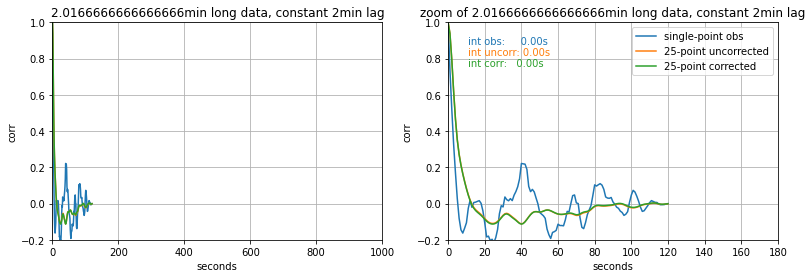

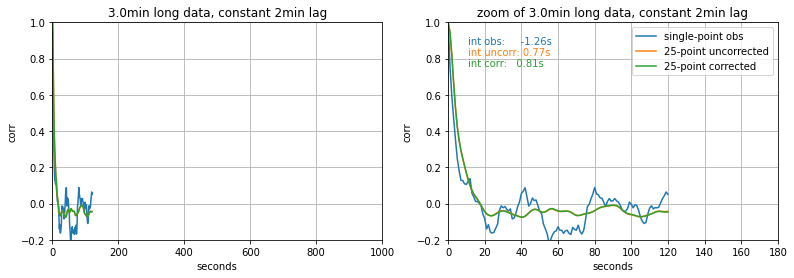

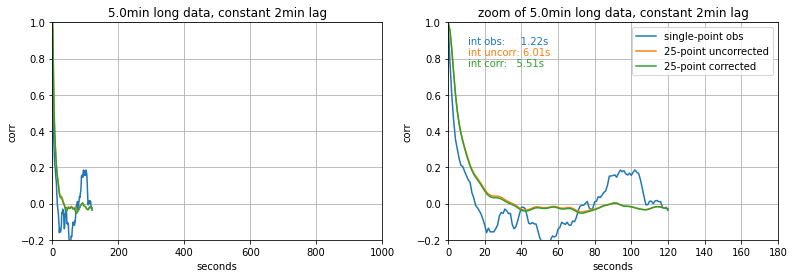

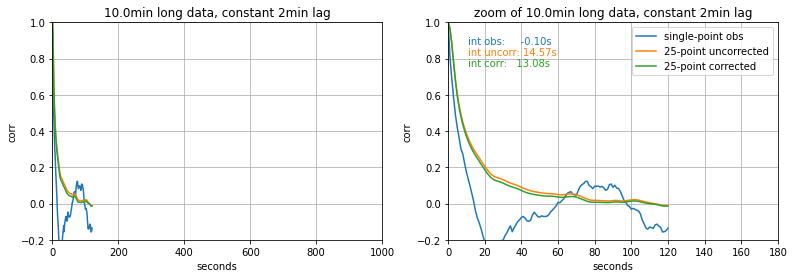

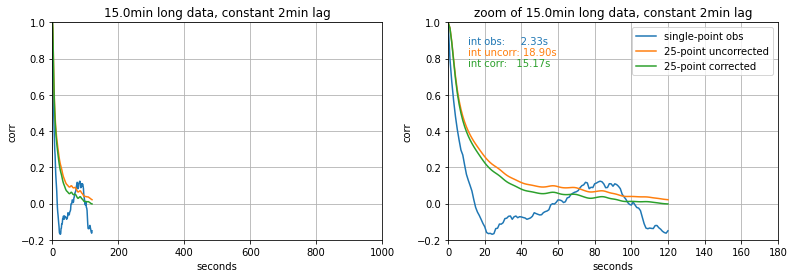

...

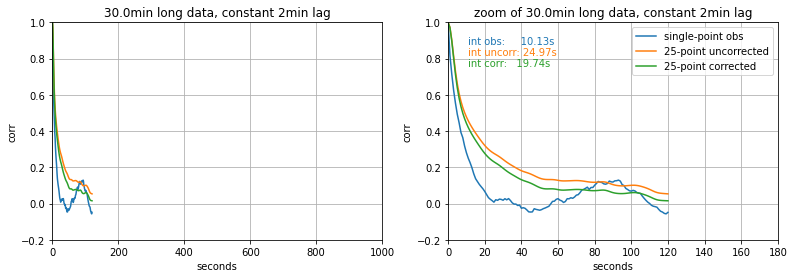

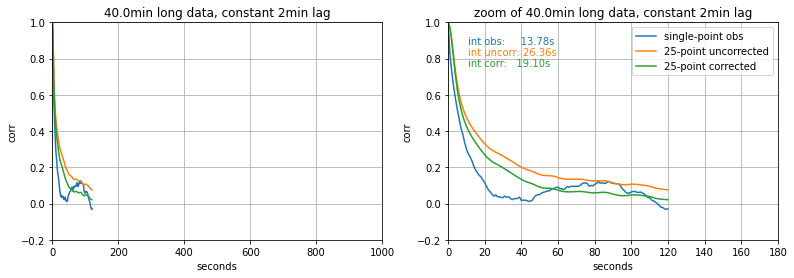

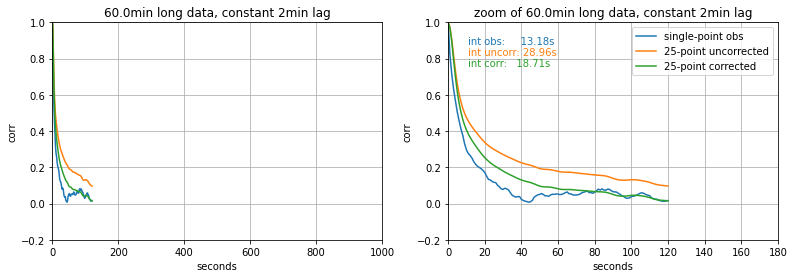

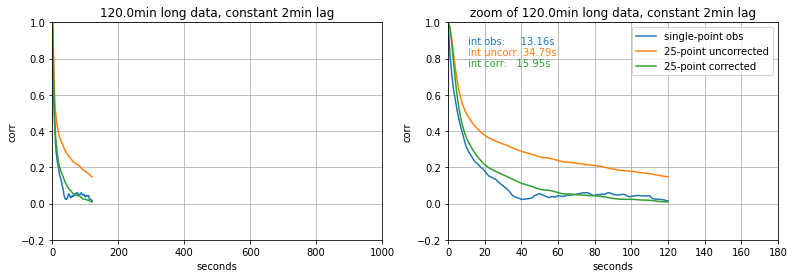

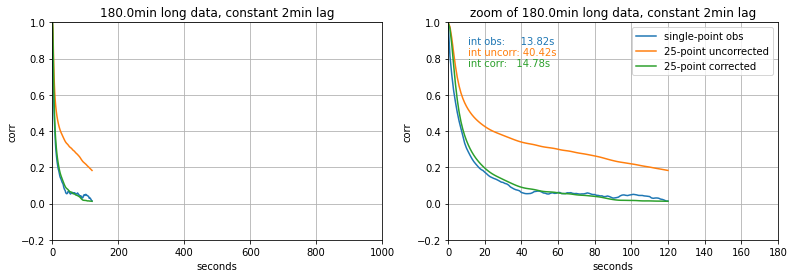

In [63]:
# varying the size of the data and keep a constant 2min lag 

lag = 120 # 2min

for interval in [2*60+1, 3*60, 5*60, 10*60, 15*60, 20*60, 30*60, 40*60, 60*60, 120*60, 180*60]:
    ti_dt = pd.to_datetime(133201,   unit='s', origin=dateref)
    tf_dt = pd.to_datetime(133200 +3*3600, unit='s', origin=dateref)

    # Window of data used (start and end)
    windowS = 0
    windowE = windowS + interval

    # 25-point uncorrected VTK data (1Hz)
    cum_acf_wspd_1Hz=[]
    wspd_1Hz_ = ds80m_corrected[['wspd']].sel(datetime=slice(ti_dt, tf_dt)).wspd
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspd_1Hz = wspd_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspd_1Hzmean = wspd_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspd_1Hzfluc = wspd_1Hz - wspd_1Hzmean
            # Get desired window
            wspd_1Hzfluc = wspd_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_1Hz = acf(wspd_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_1Hz.append(acf_wspd_1Hz)
    cum_acf_wspd_1Hz = np.mean(cum_acf_wspd_1Hz, axis=0);


    # 25-point corrected VTK data (1Hz)
    cum_acf_wspd_corr_1Hz=[]
    wspdcorr_1Hz_ = ds80m_corrected[['wspd_corr']].sel(datetime=slice(ti_dt, tf_dt)).wspd_corr
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspdcorr_1Hz = wspdcorr_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspdcorr_1Hzmean = wspdcorr_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspdcorr_1Hzfluc = wspdcorr_1Hz - wspdcorr_1Hzmean
            # Get desired window
            wspdcorr_1Hzfluc = wspdcorr_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_corr_1Hz = acf(wspdcorr_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_corr_1Hz.append(acf_wspd_corr_1Hz)
    cum_acf_wspd_corr_1Hz = np.mean(cum_acf_wspd_corr_1Hz, axis=0);


    # Single-point observation data (upsampled to 1Hz)
    wspd_obs_1Hz_ = obs1Hzfluc.sel(datetime=slice(ti_dt, tf_dt), height=80).wspd
    # Get desired window
    wspd_obs_1Hz = wspd_obs_1Hz_.isel(datetime=slice(windowS,windowE))
    # Create time array of length lag
    times_obs_1Hz = np.arange(0, lag+1, 1)
    # Compute autoccorelation
    acf_wspd_obs_1Hz = acf(wspd_obs_1Hz, nlags=lag,  fft=True)

    
    # Computer integral time scales
    tau_corr = np.trapz(cum_acf_wspd_corr_1Hz)
    tau_unc  = np.trapz(cum_acf_wspd_1Hz)
    tau_obs  = np.trapz(acf_wspd_obs_1Hz)
    

    fig, axs = plt.subplots(ncols=2, figsize=(13,4))
    axs[0].plot(times_obs_1Hz, acf_wspd_obs_1Hz);    axs[1].plot(times_obs_1Hz, acf_wspd_obs_1Hz, label='single-point obs'); 
    axs[0].plot(times_1Hz, cum_acf_wspd_1Hz);        axs[1].plot(times_1Hz, cum_acf_wspd_1Hz, label='25-point uncorrected'); 
    axs[0].plot(times_1Hz, cum_acf_wspd_corr_1Hz);   axs[1].plot(times_1Hz, cum_acf_wspd_corr_1Hz,label='25-point corrected'); 
    
    axs[1].text(0.06, 0.9,  f'int obs:     {tau_obs:.2f}s', transform = axs[1].transAxes, color='C0')
    axs[1].text(0.06, 0.85, f'int uncorr: {tau_unc:.2f}s', transform = axs[1].transAxes, color='C1')
    axs[1].text(0.06, 0.80, f'int corr:   {tau_corr:.2f}s', transform = axs[1].transAxes, color='C2')

    axs[0].set_ylim([-0.2, 1]);  axs[0].set_xlim([0, 1000]);   axs[0].set_title(f'{interval/60}min long data, constant 2min lag');
    axs[1].set_ylim([-0.2, 1]);  axs[1].set_xlim([0, 180]);    axs[1].set_title(f'zoom of {interval/60}min long data, constant 2min lag');
    axs[1].legend(loc='upper right')
    for ax in axs: ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid();

### Average in time using a fixed window

The plots above show no indication of convergence for the obs data. The results always change given the window of data we give. On top of that, the obs correlations appear very "wavy". I'm not sure why we have that clear frequency there. It is interesting, though, that the corrected data converges. Remember that the corrected and uncorrected is already relatively smooth because it is an average of 25 locations, while the obs is coming from a single mast.

The idea now is to get x-min chunks in a rolling window in time and average them. The obs should become relatively smooth, like it happened to the spatial correlation before. That "wigglyness" is probably due to the fact that in that first window, starting at 01Z, the flow has some imprint of that frequency and thus that is what we are seeing-- and consequently no convergence. 

Here we perform the same procedure as above, but fix the window. A few sets of 4 plots are shown for each fixed window. For all cases, the rolling window will only move 10min at a time, but keep the window size constant. The lag is also kept constant at 2 min.

A few goals for these plots:
- Do the correct data and obs same similar correlation decay on a time average sense?
- Is the uncorrect data actually different?
- Achieve convergence on the window choice. As we saw, we had convergence on the lag amount but not on the window, and now we want to see window convergence here
- The previous spatial correlation was performed on a 30min window-- do we get the equivalent result here using a 30min window?

The values shown on the plots are integral time scales

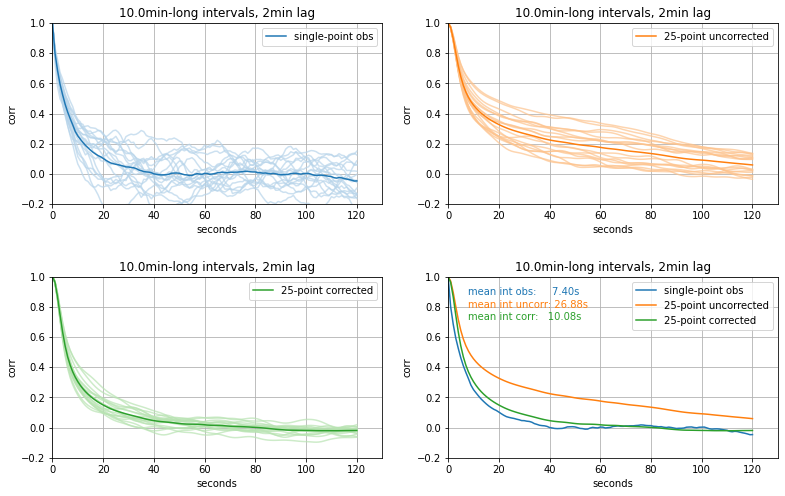

In [64]:
# ---- 10min data

# Fixed internal
interval = 10*60 # 20min

# Now fix lag at 2min and window increment at 10min and loop over the entire time
lag = 120 # 2min
windowIncrement = 10*60  # in minutes

# Initialize total arrays to accumulate data
total_wspd = []
total_wspd_corr = []
total_obs = []
tau_wspd = [];  tau_wspd_corr = [];  tau_obs = []

# Set time limits for get entire array
ti_dt = pd.to_datetime(133201,   unit='s', origin=dateref)
tf_dt = pd.to_datetime(133200 +3*3600, unit='s', origin=dateref)
wspd_1Hz_ =     ds80m_corrected[['wspd']].sel(datetime=slice(ti_dt, tf_dt)).wspd
wspdcorr_1Hz_ = ds80m_corrected[['wspd_corr']].sel(datetime=slice(ti_dt, tf_dt)).wspd_corr
wspd_obs_1Hz_ = obs1Hzfluc.sel(datetime=slice(ti_dt, tf_dt), height=80).wspd    
    
for windowS in np.arange(0,180*60-interval+1,windowIncrement):
    # Window of data used (start and end)
    windowE = windowS + interval

    # 25-point uncorrected VTK data (1Hz)
    cum_acf_wspd_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspd_1Hz = wspd_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspd_1Hzmean = wspd_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspd_1Hzfluc = wspd_1Hz - wspd_1Hzmean
            # Get desired window
            wspd_1Hzfluc = wspd_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_1Hz = acf(wspd_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_1Hz.append(acf_wspd_1Hz)
    cum_acf_wspd_1Hz = np.mean(cum_acf_wspd_1Hz, axis=0);
    total_wspd.append(cum_acf_wspd_1Hz)


    # 25-point corrected VTK data (1Hz)
    cum_acf_wspd_corr_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspdcorr_1Hz = wspdcorr_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspdcorr_1Hzmean = wspdcorr_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspdcorr_1Hzfluc = wspdcorr_1Hz - wspdcorr_1Hzmean
            # Get desired window
            wspdcorr_1Hzfluc = wspdcorr_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_corr_1Hz = acf(wspdcorr_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_corr_1Hz.append(acf_wspd_corr_1Hz)
    cum_acf_wspd_corr_1Hz = np.mean(cum_acf_wspd_corr_1Hz, axis=0);
    total_wspd_corr.append(cum_acf_wspd_corr_1Hz)


    # Single-point observation data
    # Get desired window
    wspd_obs_1Hz = wspd_obs_1Hz_.isel(datetime=slice(windowS,windowE))
    # Create time array of length lag
    times_obs_1Hz = np.arange(0, lag+1, 1)
    # Compute autoccorelation
    acf_wspd_obs_1Hz = acf(wspd_obs_1Hz, nlags=lag,  fft=True)
    total_obs.append(acf_wspd_obs_1Hz)
    
    # Compute integral time scales
    tau_wspd.append(np.trapz(cum_acf_wspd_1Hz))
    tau_wspd_corr.append(np.trapz(cum_acf_wspd_corr_1Hz))
    tau_obs.append(np.trapz(acf_wspd_obs_1Hz))
    
    
# ------ PLOTS ------
fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(13,8), gridspec_kw={'hspace': 0.4});  axs=axs.flatten()
for p in range(len(tau_obs)):
    axs[0].set_prop_cycle('color',[plt.cm.Blues(i)   for i in np.linspace(0.3, 1, len(tau_obs))])
    axs[1].set_prop_cycle('color',[plt.cm.Oranges(i) for i in np.linspace(0.3, 1, len(tau_obs))])
    axs[2].set_prop_cycle('color',[plt.cm.Greens(i)  for i in np.linspace(0.3, 1, len(tau_obs))])
    
    axs[0].plot(times_obs_1Hz, total_obs[p],   alpha=0.7);
    axs[1].plot(times_1Hz, total_wspd[p],      alpha=0.7);     
    axs[2].plot(times_1Hz, total_wspd_corr[p], alpha=0.7);
    
axs[0].plot(times_obs_1Hz, np.vstack(total_obs).mean(axis=0),   c='tab:blue',   label='single-point obs'); 
axs[1].plot(times_1Hz, np.vstack(total_wspd).mean(axis=0),      c='tab:orange', label='25-point uncorrected');
axs[2].plot(times_1Hz, np.vstack(total_wspd_corr).mean(axis=0), c='tab:green',  label='25-point corrected');


# mean-curves only plot
axs[3].plot(times_obs_1Hz, np.vstack(total_obs).mean(axis=0),   c='tab:blue',   label='single-point obs'); 
axs[3].plot(times_1Hz, np.vstack(total_wspd).mean(axis=0),      c='tab:orange', label='25-point uncorrected'); 
axs[3].plot(times_1Hz, np.vstack(total_wspd_corr).mean(axis=0), c='tab:green',  label='25-point corrected');

axs[3].text(0.06, 0.9,  f'mean int obs:     {np.mean(tau_obs):.2f}s',      transform = axs[3].transAxes, color='tab:blue')
axs[3].text(0.06, 0.83, f'mean int uncorr: {np.mean(tau_wspd):.2f}s',      transform = axs[3].transAxes, color='tab:orange')
axs[3].text(0.06, 0.76, f'mean int corr:   {np.mean(tau_wspd_corr):.2f}s', transform = axs[3].transAxes, color='tab:green')

for ax in axs: 
    ax.set_ylim([-0.2, 1]);  ax.set_xlim([0, 130]);   ax.set_title(f'{interval/60:.1f}min-long intervals, 2min lag');
    ax.legend(loc='upper right')
    ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid();

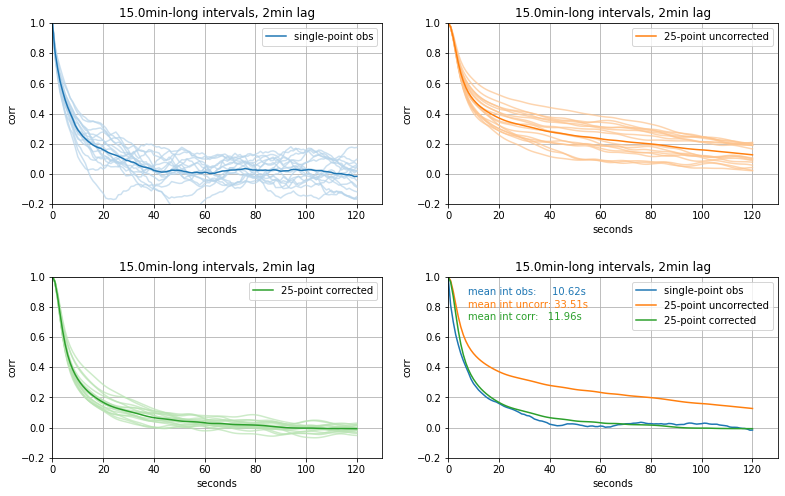

In [65]:
# ---- 15min data

# Fixed internal
interval = 15*60 # 20min

# Now fix lag at 2min and window increment at 10min and loop over the entire time
lag = 120 # 2min
windowIncrement = 10*60  # in minutes

# Initialize total arrays to accumulate data
total_wspd = []
total_wspd_corr = []
total_obs = []
tau_wspd = [];  tau_wspd_corr = [];  tau_obs = []

# Set time limits for get entire array
ti_dt = pd.to_datetime(133201,   unit='s', origin=dateref)
tf_dt = pd.to_datetime(133200 +3*3600, unit='s', origin=dateref)
wspd_1Hz_ =     ds80m_corrected[['wspd']].sel(datetime=slice(ti_dt, tf_dt)).wspd
wspdcorr_1Hz_ = ds80m_corrected[['wspd_corr']].sel(datetime=slice(ti_dt, tf_dt)).wspd_corr
wspd_obs_1Hz_ = obs1Hzfluc.sel(datetime=slice(ti_dt, tf_dt), height=80).wspd    
    
for windowS in np.arange(0,180*60-interval+1,windowIncrement):
    # Window of data used (start and end)
    windowE = windowS + interval

    # 25-point uncorrected VTK data (1Hz)
    cum_acf_wspd_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspd_1Hz = wspd_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspd_1Hzmean = wspd_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspd_1Hzfluc = wspd_1Hz - wspd_1Hzmean
            # Get desired window
            wspd_1Hzfluc = wspd_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_1Hz = acf(wspd_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_1Hz.append(acf_wspd_1Hz)
    cum_acf_wspd_1Hz = np.mean(cum_acf_wspd_1Hz, axis=0);
    total_wspd.append(cum_acf_wspd_1Hz)


    # 25-point corrected VTK data (1Hz)
    cum_acf_wspd_corr_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspdcorr_1Hz = wspdcorr_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspdcorr_1Hzmean = wspdcorr_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspdcorr_1Hzfluc = wspdcorr_1Hz - wspdcorr_1Hzmean
            # Get desired window
            wspdcorr_1Hzfluc = wspdcorr_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_corr_1Hz = acf(wspdcorr_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_corr_1Hz.append(acf_wspd_corr_1Hz)
    cum_acf_wspd_corr_1Hz = np.mean(cum_acf_wspd_corr_1Hz, axis=0);
    total_wspd_corr.append(cum_acf_wspd_corr_1Hz)


    # Single-point observation data
    # Get desired window
    wspd_obs_1Hz = wspd_obs_1Hz_.isel(datetime=slice(windowS,windowE))
    # Create time array of length lag
    times_obs_1Hz = np.arange(0, lag+1, 1)
    # Compute autoccorelation
    acf_wspd_obs_1Hz = acf(wspd_obs_1Hz, nlags=lag,  fft=True)
    total_obs.append(acf_wspd_obs_1Hz)
    
    # Compute integral time scales
    tau_wspd.append(np.trapz(cum_acf_wspd_1Hz))
    tau_wspd_corr.append(np.trapz(cum_acf_wspd_corr_1Hz))
    tau_obs.append(np.trapz(acf_wspd_obs_1Hz))
    
    
# ------ PLOTS ------
fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(13,8), gridspec_kw={'hspace': 0.4});  axs=axs.flatten()
for p in range(len(tau_obs)):
    axs[0].set_prop_cycle('color',[plt.cm.Blues(i)   for i in np.linspace(0.3, 1, len(tau_obs))])
    axs[1].set_prop_cycle('color',[plt.cm.Oranges(i) for i in np.linspace(0.3, 1, len(tau_obs))])
    axs[2].set_prop_cycle('color',[plt.cm.Greens(i)  for i in np.linspace(0.3, 1, len(tau_obs))])
    
    axs[0].plot(times_obs_1Hz, total_obs[p],   alpha=0.7);
    axs[1].plot(times_1Hz, total_wspd[p],      alpha=0.7);     
    axs[2].plot(times_1Hz, total_wspd_corr[p], alpha=0.7);
    
axs[0].plot(times_obs_1Hz, np.vstack(total_obs).mean(axis=0),   c='tab:blue',   label='single-point obs'); 
axs[1].plot(times_1Hz, np.vstack(total_wspd).mean(axis=0),      c='tab:orange', label='25-point uncorrected');
axs[2].plot(times_1Hz, np.vstack(total_wspd_corr).mean(axis=0), c='tab:green',  label='25-point corrected');


# mean-curves only plot
axs[3].plot(times_obs_1Hz, np.vstack(total_obs).mean(axis=0),   c='tab:blue',   label='single-point obs'); 
axs[3].plot(times_1Hz, np.vstack(total_wspd).mean(axis=0),      c='tab:orange', label='25-point uncorrected'); 
axs[3].plot(times_1Hz, np.vstack(total_wspd_corr).mean(axis=0), c='tab:green',  label='25-point corrected');

axs[3].text(0.06, 0.9,  f'mean int obs:     {np.mean(tau_obs):.2f}s',      transform = axs[3].transAxes, color='tab:blue')
axs[3].text(0.06, 0.83, f'mean int uncorr: {np.mean(tau_wspd):.2f}s',      transform = axs[3].transAxes, color='tab:orange')
axs[3].text(0.06, 0.76, f'mean int corr:   {np.mean(tau_wspd_corr):.2f}s', transform = axs[3].transAxes, color='tab:green')

for ax in axs: 
    ax.set_ylim([-0.2, 1]);  ax.set_xlim([0, 130]);   ax.set_title(f'{interval/60:.1f}min-long intervals, 2min lag');
    ax.legend(loc='upper right')
    ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid();

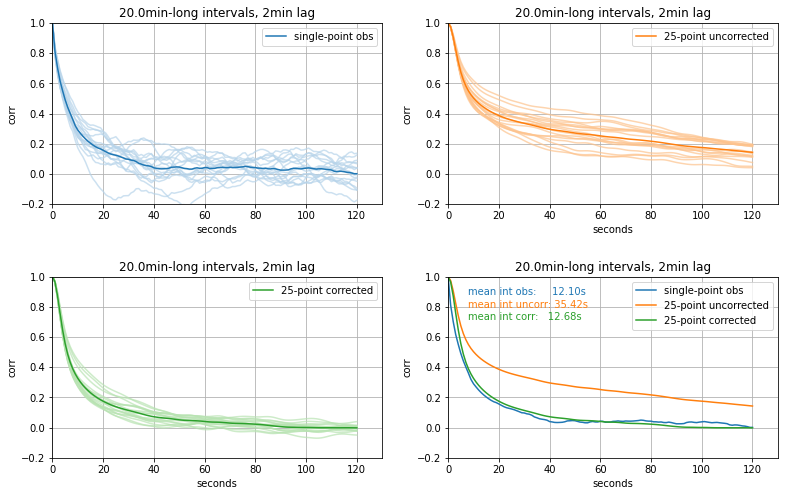

In [66]:
# ---- 20min data

# Fixed internal
interval = 20*60 # 20min

# Now fix lag at 2min and window increment at 10min and loop over the entire time
lag = 120 # 2min
windowIncrement = 10*60  # in minutes

# Initialize total arrays to accumulate data
total_wspd = []
total_wspd_corr = []
total_obs = []
tau_wspd = [];  tau_wspd_corr = [];  tau_obs = []

# Set time limits for get entire array
ti_dt = pd.to_datetime(133201,   unit='s', origin=dateref)
tf_dt = pd.to_datetime(133200 +3*3600, unit='s', origin=dateref)
wspd_1Hz_ =     ds80m_corrected[['wspd']].sel(datetime=slice(ti_dt, tf_dt)).wspd
wspdcorr_1Hz_ = ds80m_corrected[['wspd_corr']].sel(datetime=slice(ti_dt, tf_dt)).wspd_corr
wspd_obs_1Hz_ = obs1Hzfluc.sel(datetime=slice(ti_dt, tf_dt), height=80).wspd    
    
for windowS in np.arange(0,180*60-interval+1,windowIncrement):
    # Window of data used (start and end)
    windowE = windowS + interval

    # 25-point uncorrected VTK data (1Hz)
    cum_acf_wspd_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspd_1Hz = wspd_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspd_1Hzmean = wspd_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspd_1Hzfluc = wspd_1Hz - wspd_1Hzmean
            # Get desired window
            wspd_1Hzfluc = wspd_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_1Hz = acf(wspd_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_1Hz.append(acf_wspd_1Hz)
    cum_acf_wspd_1Hz = np.mean(cum_acf_wspd_1Hz, axis=0);
    total_wspd.append(cum_acf_wspd_1Hz)


    # 25-point corrected VTK data (1Hz)
    cum_acf_wspd_corr_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspdcorr_1Hz = wspdcorr_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspdcorr_1Hzmean = wspdcorr_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspdcorr_1Hzfluc = wspdcorr_1Hz - wspdcorr_1Hzmean
            # Get desired window
            wspdcorr_1Hzfluc = wspdcorr_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_corr_1Hz = acf(wspdcorr_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_corr_1Hz.append(acf_wspd_corr_1Hz)
    cum_acf_wspd_corr_1Hz = np.mean(cum_acf_wspd_corr_1Hz, axis=0);
    total_wspd_corr.append(cum_acf_wspd_corr_1Hz)


    # Single-point observation data
    # Get desired window
    wspd_obs_1Hz = wspd_obs_1Hz_.isel(datetime=slice(windowS,windowE))
    # Create time array of length lag
    times_obs_1Hz = np.arange(0, lag+1, 1)
    # Compute autoccorelation
    acf_wspd_obs_1Hz = acf(wspd_obs_1Hz, nlags=lag,  fft=True)
    total_obs.append(acf_wspd_obs_1Hz)
    
    # Compute integral time scales
    tau_wspd.append(np.trapz(cum_acf_wspd_1Hz))
    tau_wspd_corr.append(np.trapz(cum_acf_wspd_corr_1Hz))
    tau_obs.append(np.trapz(acf_wspd_obs_1Hz))
    
    
# ------ PLOTS ------
fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(13,8), gridspec_kw={'hspace': 0.4});  axs=axs.flatten()
for p in range(len(tau_obs)):
    axs[0].set_prop_cycle('color',[plt.cm.Blues(i)   for i in np.linspace(0.3, 1, len(tau_obs))])
    axs[1].set_prop_cycle('color',[plt.cm.Oranges(i) for i in np.linspace(0.3, 1, len(tau_obs))])
    axs[2].set_prop_cycle('color',[plt.cm.Greens(i)  for i in np.linspace(0.3, 1, len(tau_obs))])
    
    axs[0].plot(times_obs_1Hz, total_obs[p],   alpha=0.7);
    axs[1].plot(times_1Hz, total_wspd[p],      alpha=0.7);     
    axs[2].plot(times_1Hz, total_wspd_corr[p], alpha=0.7);
    
axs[0].plot(times_obs_1Hz, np.vstack(total_obs).mean(axis=0),   c='tab:blue',   label='single-point obs'); 
axs[1].plot(times_1Hz, np.vstack(total_wspd).mean(axis=0),      c='tab:orange', label='25-point uncorrected');
axs[2].plot(times_1Hz, np.vstack(total_wspd_corr).mean(axis=0), c='tab:green',  label='25-point corrected');


# mean-curves only plot
axs[3].plot(times_obs_1Hz, np.vstack(total_obs).mean(axis=0),   c='tab:blue',   label='single-point obs'); 
axs[3].plot(times_1Hz, np.vstack(total_wspd).mean(axis=0),      c='tab:orange', label='25-point uncorrected'); 
axs[3].plot(times_1Hz, np.vstack(total_wspd_corr).mean(axis=0), c='tab:green',  label='25-point corrected');

axs[3].text(0.06, 0.9,  f'mean int obs:     {np.mean(tau_obs):.2f}s',      transform = axs[3].transAxes, color='tab:blue')
axs[3].text(0.06, 0.83, f'mean int uncorr: {np.mean(tau_wspd):.2f}s',      transform = axs[3].transAxes, color='tab:orange')
axs[3].text(0.06, 0.76, f'mean int corr:   {np.mean(tau_wspd_corr):.2f}s', transform = axs[3].transAxes, color='tab:green')

for ax in axs: 
    ax.set_ylim([-0.2, 1]);  ax.set_xlim([0, 130]);   ax.set_title(f'{interval/60:.1f}min-long intervals, 2min lag');
    ax.legend(loc='upper right')
    ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid();

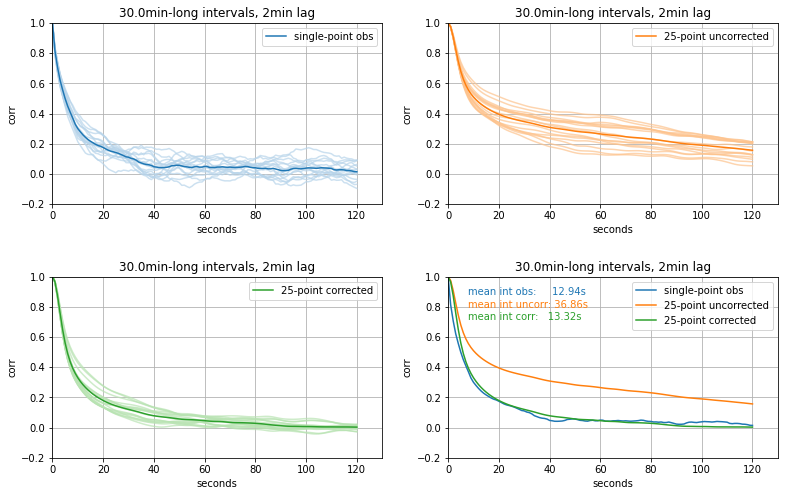

In [67]:
# ---- 30min data

# Fixed internal
interval = 30*60 # 30min

# Now fix lag at 2min and window increment at 10min and loop over the entire time
lag = 120 # 2min
windowIncrement = 10*60  # in minutes

# Initialize total arrays to accumulate data
total_wspd = []
total_wspd_corr = []
total_obs = []
tau_wspd = [];  tau_wspd_corr = [];  tau_obs = []

# Set time limits for get entire array
ti_dt = pd.to_datetime(133201,   unit='s', origin=dateref)
tf_dt = pd.to_datetime(133200 +3*3600, unit='s', origin=dateref)
wspd_1Hz_ =     ds80m_corrected[['wspd']].sel(datetime=slice(ti_dt, tf_dt)).wspd
wspdcorr_1Hz_ = ds80m_corrected[['wspd_corr']].sel(datetime=slice(ti_dt, tf_dt)).wspd_corr
wspd_obs_1Hz_ = obs1Hzfluc.sel(datetime=slice(ti_dt, tf_dt), height=80).wspd    
    
for windowS in np.arange(0,180*60-interval+1,windowIncrement):
    # Window of data used (start and end)
    windowE = windowS + interval

    # 25-point uncorrected VTK data (1Hz)
    cum_acf_wspd_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspd_1Hz = wspd_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspd_1Hzmean = wspd_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspd_1Hzfluc = wspd_1Hz - wspd_1Hzmean
            # Get desired window
            wspd_1Hzfluc = wspd_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_1Hz = acf(wspd_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_1Hz.append(acf_wspd_1Hz)
    cum_acf_wspd_1Hz = np.mean(cum_acf_wspd_1Hz, axis=0);
    total_wspd.append(cum_acf_wspd_1Hz)


    # 25-point corrected VTK data (1Hz)
    cum_acf_wspd_corr_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspdcorr_1Hz = wspdcorr_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspdcorr_1Hzmean = wspdcorr_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspdcorr_1Hzfluc = wspdcorr_1Hz - wspdcorr_1Hzmean
            # Get desired window
            wspdcorr_1Hzfluc = wspdcorr_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_corr_1Hz = acf(wspdcorr_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_corr_1Hz.append(acf_wspd_corr_1Hz)
    cum_acf_wspd_corr_1Hz = np.mean(cum_acf_wspd_corr_1Hz, axis=0);
    total_wspd_corr.append(cum_acf_wspd_corr_1Hz)


    # Single-point observation data
    # Get desired window
    wspd_obs_1Hz = wspd_obs_1Hz_.isel(datetime=slice(windowS,windowE))
    # Create time array of length lag
    times_obs_1Hz = np.arange(0, lag+1, 1)
    # Compute autoccorelation
    acf_wspd_obs_1Hz = acf(wspd_obs_1Hz, nlags=lag,  fft=True)
    total_obs.append(acf_wspd_obs_1Hz)
    
    # Compute integral time scales
    tau_wspd.append(np.trapz(cum_acf_wspd_1Hz))
    tau_wspd_corr.append(np.trapz(cum_acf_wspd_corr_1Hz))
    tau_obs.append(np.trapz(acf_wspd_obs_1Hz))
    
    
# ------ PLOTS ------
fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(13,8), gridspec_kw={'hspace': 0.4});  axs=axs.flatten()
for p in range(len(tau_obs)):
    axs[0].set_prop_cycle('color',[plt.cm.Blues(i)   for i in np.linspace(0.3, 1, len(tau_obs))])
    axs[1].set_prop_cycle('color',[plt.cm.Oranges(i) for i in np.linspace(0.3, 1, len(tau_obs))])
    axs[2].set_prop_cycle('color',[plt.cm.Greens(i)  for i in np.linspace(0.3, 1, len(tau_obs))])
    
    axs[0].plot(times_obs_1Hz, total_obs[p],   alpha=0.7);
    axs[1].plot(times_1Hz, total_wspd[p],      alpha=0.7);     
    axs[2].plot(times_1Hz, total_wspd_corr[p], alpha=0.7);
    
axs[0].plot(times_obs_1Hz, np.vstack(total_obs).mean(axis=0),   c='tab:blue',   label='single-point obs'); 
axs[1].plot(times_1Hz, np.vstack(total_wspd).mean(axis=0),      c='tab:orange', label='25-point uncorrected');
axs[2].plot(times_1Hz, np.vstack(total_wspd_corr).mean(axis=0), c='tab:green',  label='25-point corrected');


# mean-curves only plot
axs[3].plot(times_obs_1Hz, np.vstack(total_obs).mean(axis=0),   c='tab:blue',   label='single-point obs'); 
axs[3].plot(times_1Hz, np.vstack(total_wspd).mean(axis=0),      c='tab:orange', label='25-point uncorrected'); 
axs[3].plot(times_1Hz, np.vstack(total_wspd_corr).mean(axis=0), c='tab:green',  label='25-point corrected');

axs[3].text(0.06, 0.9,  f'mean int obs:     {np.mean(tau_obs):.2f}s',      transform = axs[3].transAxes, color='tab:blue')
axs[3].text(0.06, 0.83, f'mean int uncorr: {np.mean(tau_wspd):.2f}s',      transform = axs[3].transAxes, color='tab:orange')
axs[3].text(0.06, 0.76, f'mean int corr:   {np.mean(tau_wspd_corr):.2f}s', transform = axs[3].transAxes, color='tab:green')

for ax in axs: 
    ax.set_ylim([-0.2, 1]);  ax.set_xlim([0, 130]);   ax.set_title(f'{interval/60:.1f}min-long intervals, 2min lag');
    ax.legend(loc='upper right')
    ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid();

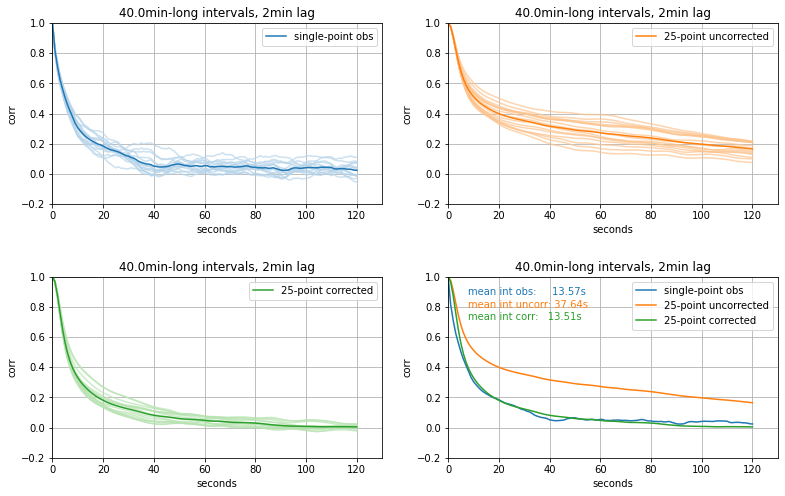

In [68]:
# ---- 40min data

# Fixed internal
interval = 40*60 # 30min

# Now fix lag at 2min and window increment at 10min and loop over the entire time
lag = 120 # 2min
windowIncrement = 10*60  # in minutes

# Initialize total arrays to accumulate data
total_wspd = []
total_wspd_corr = []
total_obs = []
tau_wspd = [];  tau_wspd_corr = [];  tau_obs = []

# Set time limits for get entire array
ti_dt = pd.to_datetime(133201,   unit='s', origin=dateref)
tf_dt = pd.to_datetime(133200 +3*3600, unit='s', origin=dateref)
wspd_1Hz_ =     ds80m_corrected[['wspd']].sel(datetime=slice(ti_dt, tf_dt)).wspd
wspdcorr_1Hz_ = ds80m_corrected[['wspd_corr']].sel(datetime=slice(ti_dt, tf_dt)).wspd_corr
wspd_obs_1Hz_ = obs1Hzfluc.sel(datetime=slice(ti_dt, tf_dt), height=80).wspd    
    
for windowS in np.arange(0,180*60-interval+1,windowIncrement):
    # Window of data used (start and end)
    windowE = windowS + interval

    # 25-point uncorrected VTK data (1Hz)
    cum_acf_wspd_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspd_1Hz = wspd_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspd_1Hzmean = wspd_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspd_1Hzfluc = wspd_1Hz - wspd_1Hzmean
            # Get desired window
            wspd_1Hzfluc = wspd_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_1Hz = acf(wspd_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_1Hz.append(acf_wspd_1Hz)
    cum_acf_wspd_1Hz = np.mean(cum_acf_wspd_1Hz, axis=0);
    total_wspd.append(cum_acf_wspd_1Hz)


    # 25-point corrected VTK data (1Hz)
    cum_acf_wspd_corr_1Hz=[]
    for i in np.arange(100, 501, 100):
        for j in np.arange(100, 501, 100):
            # Get data at specific (i,j)
            wspdcorr_1Hz = wspdcorr_1Hz_.isel(x=i, y=j)
            # Get 10-min rolling mean
            wspdcorr_1Hzmean = wspdcorr_1Hz.rolling(datetime=600, min_periods=1).mean()
            # Get fluctuating component
            wspdcorr_1Hzfluc = wspdcorr_1Hz - wspdcorr_1Hzmean
            # Get desired window
            wspdcorr_1Hzfluc = wspdcorr_1Hzfluc.isel(datetime=slice(windowS,windowE))
            # Create time array of length lag
            times_1Hz = np.arange(0, lag+1, 1)
            # Compute autoccorelation
            acf_wspd_corr_1Hz = acf(wspdcorr_1Hzfluc, nlags=lag, fft=True)
            # Accumulate autocorrelation for current (i,j)
            cum_acf_wspd_corr_1Hz.append(acf_wspd_corr_1Hz)
    cum_acf_wspd_corr_1Hz = np.mean(cum_acf_wspd_corr_1Hz, axis=0);
    total_wspd_corr.append(cum_acf_wspd_corr_1Hz)


    # Single-point observation data
    # Get desired window
    wspd_obs_1Hz = wspd_obs_1Hz_.isel(datetime=slice(windowS,windowE))
    # Create time array of length lag
    times_obs_1Hz = np.arange(0, lag+1, 1)
    # Compute autoccorelation
    acf_wspd_obs_1Hz = acf(wspd_obs_1Hz, nlags=lag,  fft=True)
    total_obs.append(acf_wspd_obs_1Hz)
    
    # Compute integral time scales
    tau_wspd.append(np.trapz(cum_acf_wspd_1Hz))
    tau_wspd_corr.append(np.trapz(cum_acf_wspd_corr_1Hz))
    tau_obs.append(np.trapz(acf_wspd_obs_1Hz))
    
    
# ------ PLOTS ------
fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(13,8), gridspec_kw={'hspace': 0.4});  axs=axs.flatten()
for p in range(len(tau_obs)):
    axs[0].set_prop_cycle('color',[plt.cm.Blues(i)   for i in np.linspace(0.3, 1, len(tau_obs))])
    axs[1].set_prop_cycle('color',[plt.cm.Oranges(i) for i in np.linspace(0.3, 1, len(tau_obs))])
    axs[2].set_prop_cycle('color',[plt.cm.Greens(i)  for i in np.linspace(0.3, 1, len(tau_obs))])
    
    axs[0].plot(times_obs_1Hz, total_obs[p],   alpha=0.7);
    axs[1].plot(times_1Hz, total_wspd[p],      alpha=0.7);     
    axs[2].plot(times_1Hz, total_wspd_corr[p], alpha=0.7);
    
axs[0].plot(times_obs_1Hz, np.vstack(total_obs).mean(axis=0),   c='tab:blue',   label='single-point obs'); 
axs[1].plot(times_1Hz, np.vstack(total_wspd).mean(axis=0),      c='tab:orange', label='25-point uncorrected');
axs[2].plot(times_1Hz, np.vstack(total_wspd_corr).mean(axis=0), c='tab:green',  label='25-point corrected');


# mean-curves only plot
axs[3].plot(times_obs_1Hz, np.vstack(total_obs).mean(axis=0),   c='tab:blue',   label='single-point obs'); 
axs[3].plot(times_1Hz, np.vstack(total_wspd).mean(axis=0),      c='tab:orange', label='25-point uncorrected'); 
axs[3].plot(times_1Hz, np.vstack(total_wspd_corr).mean(axis=0), c='tab:green',  label='25-point corrected');

axs[3].text(0.06, 0.9,  f'mean int obs:     {np.mean(tau_obs):.2f}s',      transform = axs[3].transAxes, color='tab:blue')
axs[3].text(0.06, 0.83, f'mean int uncorr: {np.mean(tau_wspd):.2f}s',      transform = axs[3].transAxes, color='tab:orange')
axs[3].text(0.06, 0.76, f'mean int corr:   {np.mean(tau_wspd_corr):.2f}s', transform = axs[3].transAxes, color='tab:green')

for ax in axs: 
    ax.set_ylim([-0.2, 1]);  ax.set_xlim([0, 130]);   ax.set_title(f'{interval/60:.1f}min-long intervals, 2min lag');
    ax.legend(loc='upper right')
    ax.set_ylabel('corr');  ax.set_xlabel('seconds'); ax.grid();

### Conclusions so far

Averaging the chunks of temporal correlations result in a nice match between the corrected data and obs. We have also achieved window convergence. Some final values that we can keep using moving forward:

- Lag: 2min
- Data window: 15min

We can make a comparison between the temporal and spatial correlations. Looking at the plots for the spatial and the integral time scale over time, an average of that value is close to the average integral time scale computed here. The average value doesn't really tell us a lot in terms of actual integral scales, but it's a nice tool to smooth out obs values